In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
# get reads original
adata1=sc.read('../../data/unprocessed_adata/ms_brain_rep2.h5ad')
reads_original=adata1.uns['spots']
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters.h5ad')
adata1=adata[adata.obs['replicate']=='2']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation_expanded']=reads_original['cell_id'].map(id_cluster)
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation.h5ad')
adata1=adata[adata.obs['replicate']=='2']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['celltype_annotation']))
reads_original['initial_annotation']=reads_original['cell_id'].map(id_cluster)

In [23]:
reads_original

,cell_id,overlaps_nucleus,feature_name,x_location,y_location,z_location,qv,initial_annotation_expanded,initial_annotation
transcript_id,,,,,,,,,
281496451547136,5335,1,Dkk3,108.882760,1191.4623,15.111133,14.470180,21_Ependymal,Ependymal
281496451547137,4908,1,Neurod6,599.608800,1214.9828,13.810570,17.666338,2_CA3,CA2_3
281496451547138,7469,1,Ipcef1,40.342777,1966.5145,14.667373,9.514981,6_L6 CT CTX,L6 CT Syt6
281496451547139,7485,1,Bhlhe40,34.722248,2017.1637,15.058671,13.275211,6_L6 CT CTX,L6 CT Syt6
281496451547140,4905,1,Car4,623.589000,1048.9484,15.842804,29.903952,7_Endo_pericytes_CA,Car4+ EC
...,...,...,...,...,...,...,...,...,...
281513631904696,28317,1,Cdh13,2738.748300,1722.5444,28.736680,14.214149,19_Oligo_thalamus,Oligo
281513631904697,28334,1,Fign,2618.527000,1743.7420,29.148848,40.000000,16_MFOL_MOL_thalamus,Oligo
281513631904698,2563,1,Zfp536,2907.959700,1812.5348,28.413157,15.674445,19_Oligo_thalamus,Oligo


In [24]:
reads_original=reads_original.reset_index()

In [25]:
reads_original['ind']=reads_original.index

In [26]:
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_cytoplasm.h5ad')
adata1=adata[adata.obs['replicate']=='2']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation_cytoplasm']=reads_original['cell_id'].map(id_cluster)

In [8]:
cross=pd.crosstab(reads_original['initial_annotation'],reads_original['initial_annotation_expanded'])

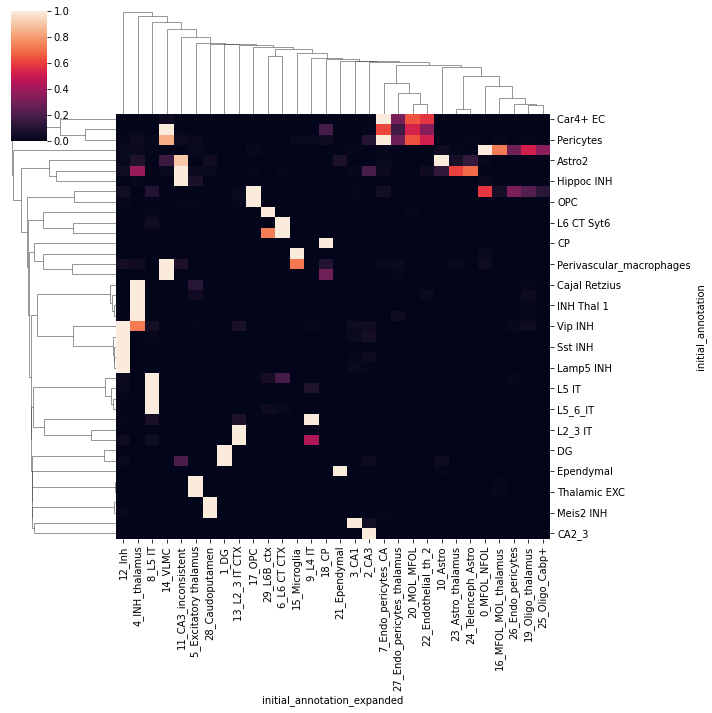

In [9]:
sns.clustermap(cross,standard_scale='var')

In [41]:
# Annotation

In [30]:
kmeans_100=pd.read_csv("../../figures/4.fast_kmeans/results/ms_brain_rep2_spots_sigma3.0_stride1.0_clusters100.csv")
kmeans_100=kmeans_100.loc[:,['x_location','y_location','region']]
kmeans_100.columns=['x_location','y_location','kmeans_100']
reads_original=reads_original.merge(kmeans_100,on=['x_location','y_location'])

In [31]:
kmeans_200=pd.read_csv("../../figures/4.fast_kmeans/results/ms_brain_rep2_spots_sigma3.0_stride1.0_clusters200.csv")
kmeans_200=kmeans_200.loc[:,['x_location','y_location','region']]
kmeans_200.columns=['x_location','y_location','kmeans_200']
reads_original=reads_original.merge(kmeans_200,on=['x_location','y_location'])

In [32]:
kmeans_500=pd.read_csv("../../figures/4.fast_kmeans/results/ms_brain_rep2_spots_sigma3.0_stride1.0_clusters500.csv")
kmeans_500=kmeans_500.loc[:,['x_location','y_location','region']]
kmeans_500.columns=['x_location','y_location','kmeans_500']
reads_original=reads_original.merge(kmeans_500,on=['x_location','y_location'])

In [14]:
#reads_original.to_csv('../../data/celltyping_csv/kmeans_sample1.csv')

In [36]:
reads_original['kmeans_100']=reads_original['kmeans_100_x']

In [37]:
crosst=pd.crosstab(reads_original['initial_annotation'],reads_original['kmeans_100'])

In [38]:
reads_original['initial_annotation'].unique()

array(['Ependymal', 'CA2_3', 'L6 CT Syt6', 'Car4+ EC', 'L4_5 IT', 'Oligo',
       'Pericytes', 'Lamp5 INH', 'Sst INH', 'Astro1', 'Astro2', nan,
       'Microglia', 'CA1', 'Pvalb INH', 'Perivascular_macrophages', 'OPC',
       'Cck INH', 'COP', 'L6b CTX', 'Car4- EC', 'Vip INH', 'Car3 EXC',
       'Meis2 INH', 'L5_6_IT', 'VLMC', 'DG', 'L5 NP', 'L5 IT ', 'L5 PT',
       'L4 IT', 'L2_3 IT', 'Caudoputamen EXC', 'CP', 'INH Thal 2',
       'Granule neuroblasts (DG)', 'Cajal Retzius', 'Hippoth EXC',
       'INH Thal 3', 'Thalamic EXC', 'INH Thal 1', 'Hippoc INH'],
      dtype=object)

In [39]:
closest_celltype=dict(zip(crosst.idxmax().index,crosst.idxmax()))
reads_original['closest_celltype']=list(reads_original['kmeans_100'].map(closest_celltype))
#reads_original.loc[reads_original['closest_celltype']==cl]

In [17]:
for cl in reads_original['closest_celltype'].unique():
    sub=reads_original.loc[reads_original['closest_celltype']==cl]
    sub.to_csv('../../figures/4.fast_kmeans/results/'+cl+'.csv')

<Figure size 1000x1000 with 0 Axes>

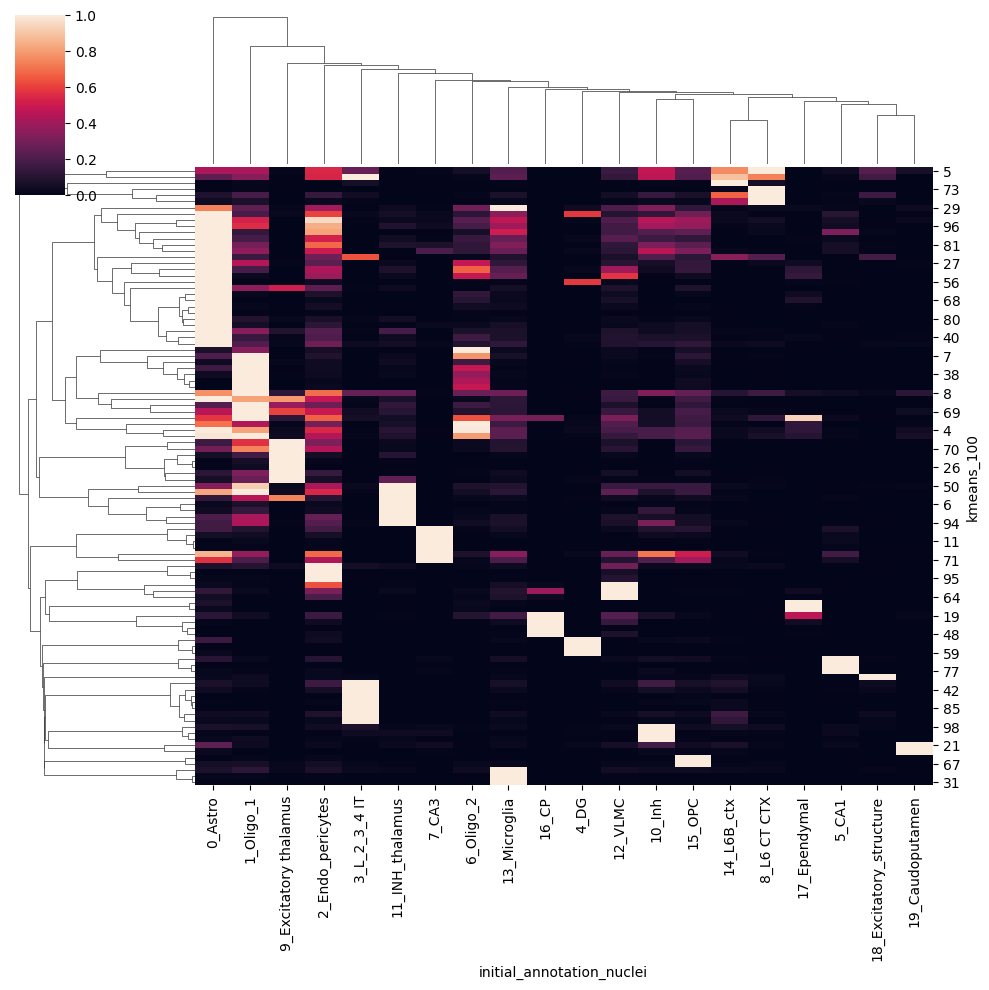

In [51]:
plt.figure(figsize=(10,10))
sns.clustermap(crosst.transpose(),standard_scale='var')

# Work with kmeans_clusters

In [21]:
#reads_original=pd.read_csv('../../data/celltyping_csv/kmeans_sample1.csv')

In [ ]:
reads_original.shape

In [40]:
reads_original['read_location']=reads_original['overlaps_nucleus']
dictio={1:'nuclei',0:'cytoplasm'}
reads_original['read_location']=reads_original['read_location'].map(dictio)
reads_original.loc[reads_original['cell_id']==-1,'read_location']='out'
location_clusters=pd.crosstab(reads_original['read_location'],reads_original['kmeans_100'])
location_clusters=location_clusters.div(location_clusters.sum(axis=1),axis=0)
location_clusters=location_clusters.div(location_clusters.sum(axis=0),axis=1).transpose()
location_clusters=location_clusters.sort_values(by='out')

In [41]:
location_dict=dict(zip(location_clusters.idxmax(axis=1).index,location_clusters.idxmax(axis=1)))

In [42]:
reads_original['location']=reads_original['kmeans_100'].map(location_dict)

In [21]:
for cl in reads_original['closest_celltype'].unique():
    sub=reads_original.loc[reads_original['closest_celltype']==cl]
    sub.to_csv('../../figures/4.fast_kmeans/results/'+cl+'.csv')

In [22]:
for cl in reads_original['location'].unique():
    sub=reads_original.loc[reads_original['location']==cl]
    sub.to_csv('../../figures/4.fast_kmeans/results/'+cl+'.csv')

In [43]:
expression=pd.crosstab(reads_original['feature_name'],reads_original['kmeans_100'])
expression=expression.loc[expression.index.isin(adata.var.index),:]
expression2=expression.transpose()

In [44]:
col={'cytoplasm':'red','nuclei':'blue','out':'green'}

In [45]:
k100_to_initial=dict(zip(reads_original['kmeans_100'],reads_original['initial_annotation']))

In [46]:
adatanuc=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation.h5ad')

In [47]:
adata.var

,highly_variable,means,dispersions,dispersions_norm
index,,,,
2010300C02Rik,True,5.046709,5.656327,0.617735
Acsbg1,True,4.944390,5.524144,-0.062881
Acta2,True,3.246466,6.561280,2.485068
Acvrl1,True,2.538999,5.249338,0.703148
Adamts2,False,2.019882,4.799899,-0.717214
...,...,...,...,...
Vwc2l,False,2.411150,4.709616,-0.737703
Wfs1,True,3.723889,5.329240,0.004525
Zfp366,True,1.585471,5.035729,-0.001987


In [49]:
initial_to_col=dict(zip(reads_original['initial_annotation'].unique(),adatanuc.uns['celltype_annotation_colors']))

KeyError: 'celltype_annotation_colors'

/home/sergioms/.local/lib/python3.8/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


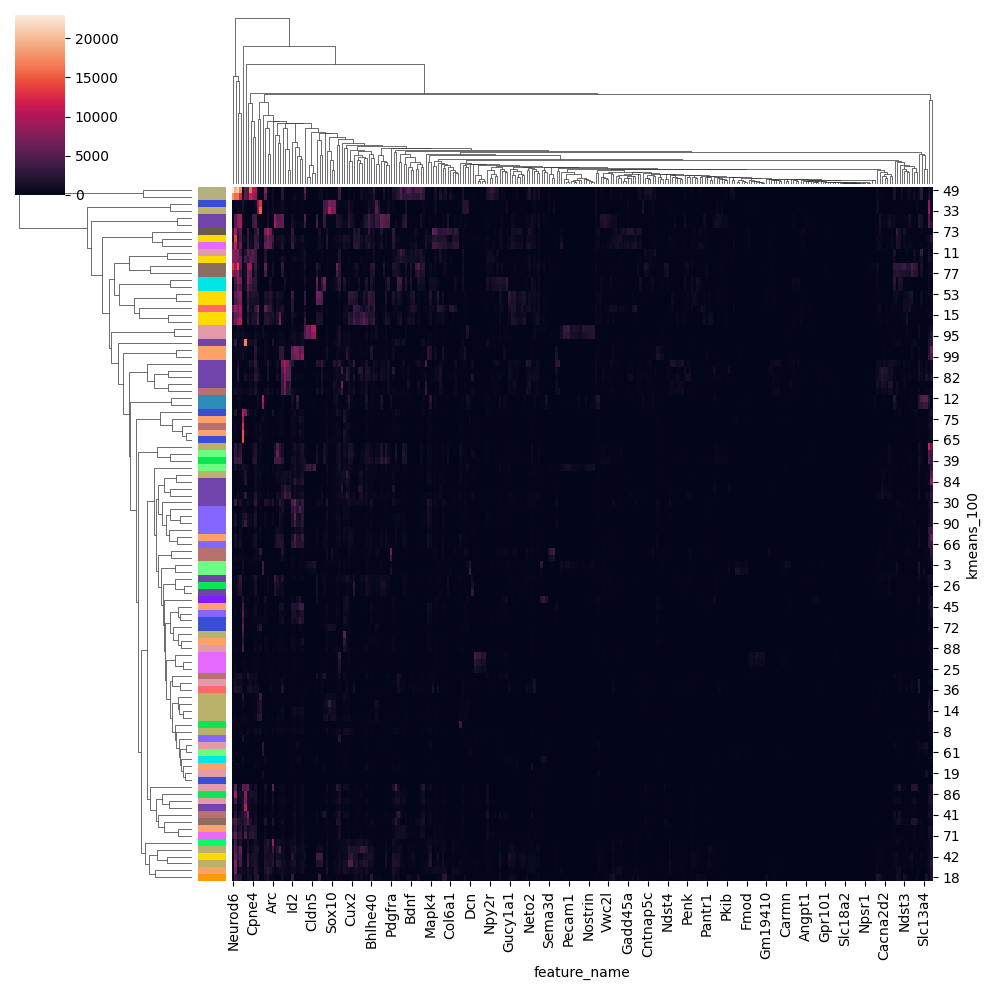

In [61]:
sns.clustermap(expression.transpose(),row_colors=expression.columns.map(k100_to_initial).map(initial_to_col))

/home/sergioms/.local/lib/python3.8/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


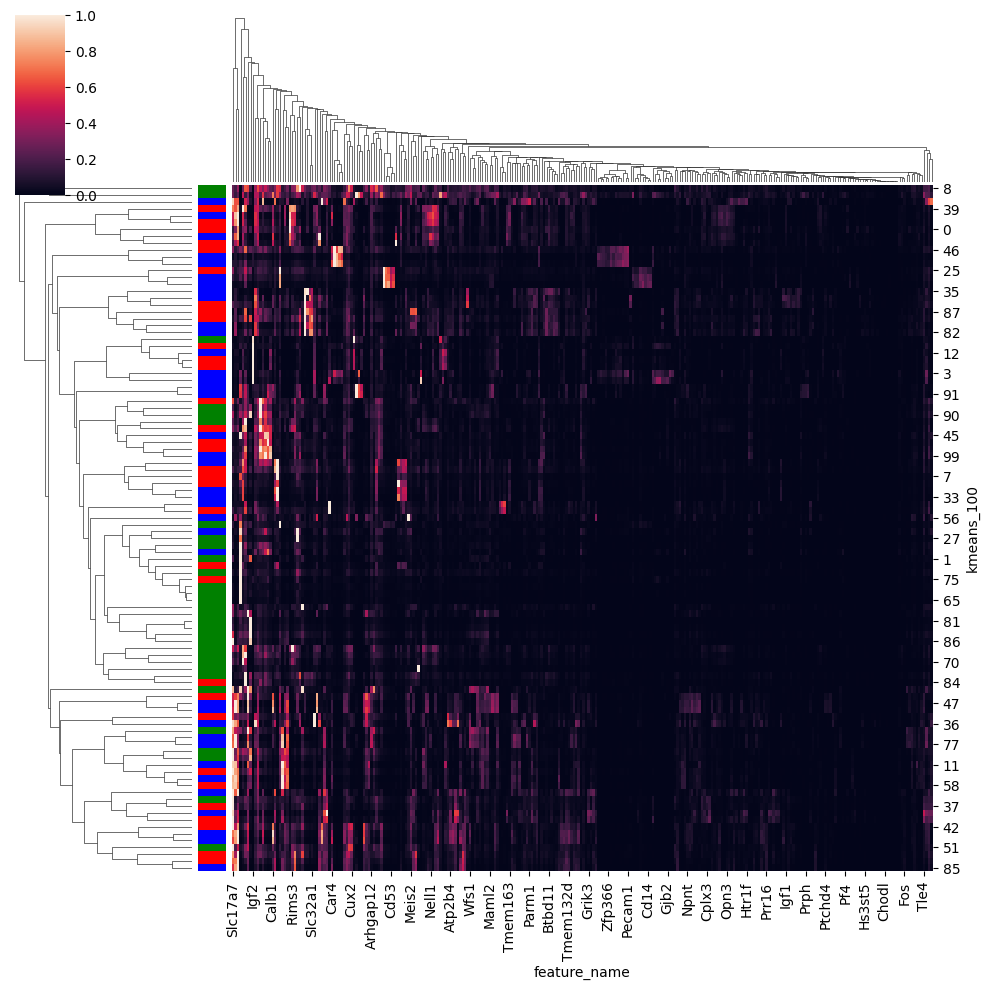

In [62]:
sns.clustermap(expression.transpose(),row_colors=expression.columns.map(location_dict).map(col),standard_scale='var')

# Work with correlations

In [63]:
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei.h5ad')

In [47]:
res = pd.DataFrame(columns=adata.var_names, index=adata.obs['initial_annotation'].cat.categories)                                                                                                 
for clust in adata.obs.initial_annotation.cat.categories: 
    res.loc[clust] = adata[adata.obs['initial_annotation'].isin([clust]),:].X.mean(0)
res=res.loc[:,res.columns.sort_values()]
corres=pd.DataFrame(index=res.index,columns=expression2.index)
for ref_cl in  res.index:
    for kind in expression2.index:
            corres.loc[ref_cl,kind]=np.corrcoef(list(res.loc[ref_cl,:]),list(expression2.loc[kind,:]))[0,1]

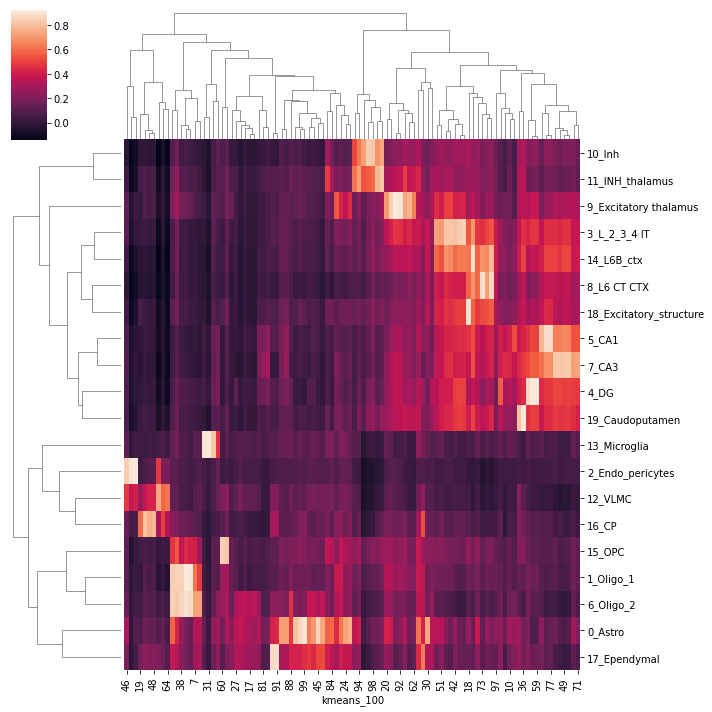

In [48]:
sns.clustermap(corres.astype(float))

In [49]:
correlation_kmeans_to_initial=dict(zip(corres.astype(float).idxmax().index,corres.astype(float).idxmax()))

In [50]:
reads_original['correlated_celltype']=reads_original['kmeans_100'].map(correlation_kmeans_to_initial)

In [51]:
reads_original['consistent_related_cluster']=reads_original['closest_celltype']==reads_original['correlated_celltype']

In [52]:
reads_inconsistent=reads_original[reads_original['consistent_related_cluster']!=True]

In [53]:
reads_original.loc[reads_original['kmeans_100']==66,['closest_celltype','correlated_celltype']]

,closest_celltype,correlated_celltype
22404,0_Astro,0_Astro
27625,0_Astro,0_Astro
35300,0_Astro,0_Astro
60709,0_Astro,0_Astro
64016,0_Astro,0_Astro
...,...,...
7619702,0_Astro,0_Astro
7619751,0_Astro,0_Astro
7619922,0_Astro,0_Astro
7620778,0_Astro,0_Astro


In [54]:
anno_to_class=dict(zip(adata.obs['initial_annotation'],adata.obs['Class']))
reads_original['Class']=reads_original['closest_celltype'].map(anno_to_class)

In [55]:
reads_original['Class'].unique()

array(['Excitatory', 'CA', 'Ependymal', 'Oligo', 'Microglia',
       'Inhibitory', 'Astro', 'Vascular', 'CP', 'Unknown'], dtype=object)

In [56]:
reads_original.loc[reads_original['Class']=='Oligo','kmeans_100'].unique()

array([54, 52, 38, 88, 22, 69, 33, 60, 14, 65, 72,  8,  7, 67, 34])

In [550]:
for cl in reads_original['Class'].unique():
    sub=reads_original.loc[reads_original['closest_celltype']==cl]
    sub.to_csv('../../figures/4.fast_kmeans/results/'+cl+'.csv')

In [551]:
reads_original

,transcript_id,cell_id,overlaps_nucleus,feature_name,x_location,y_location,z_location,qv,initial_annotation,initial_annotation_nuclei,initial_annotation_cytoplasm,kmeans_100,kmeans_200,kmeans_500,closest_celltype,read_location,location,correlated_celltype,consistent_related_cluster,Class
0,281496451547136,6435,1,NegControlCodeword_0505,47.404972,2041.5103,13.592865,19.736050,12_Inh,8_L6 CT CTX,2_L5_5 CTX,37,103,135,8_L6 CT CTX,nuclei,cytoplasm,8_L6 CT CTX,True,Excitatory
1,281496451547138,5788,0,Neurod6,597.499200,1908.6559,13.913390,19.505224,2_CA3,7_CA3,6_CA3,11,41,44,7_CA3,cytoplasm,nuclei,7_CA3,True,CA
2,281496451547139,4819,1,Neurod6,596.572800,1062.4052,15.545630,19.797620,2_CA3,7_CA3,6_CA3,58,52,405,7_CA3,nuclei,cytoplasm,7_CA3,True,CA
3,281496451547140,5139,1,Dkk3,176.066730,1187.6486,14.824332,19.784027,21_Ependymal,17_Ependymal,12_Ependymal,55,95,428,17_Ependymal,nuclei,nuclei,17_Ependymal,True,Ependymal
4,281496451547141,5220,0,Neurod6,608.989800,1246.7114,14.733643,19.737194,2_CA3,7_CA3,6_CA3,58,51,108,7_CA3,cytoplasm,cytoplasm,7_CA3,True,CA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7620998,281513631826456,2248,1,Parm1,2903.128700,1953.1665,28.603460,20.588556,4_INH_thalamus,11_INH_thalamus,5_Thalamus_2,0,169,274,11_INH_thalamus,nuclei,cytoplasm,9_Excitatory thalamus,False,Inhibitory
7620999,281513631826457,2231,1,Sema6a,2918.454300,1816.0531,29.642420,13.637909,4_INH_thalamus,11_INH_thalamus,5_Thalamus_2,35,168,200,10_Inh,nuclei,nuclei,10_Inh,True,Inhibitory
7621000,281513631826458,2231,0,Rasgrf2,2921.778300,1818.0233,29.178177,15.616901,4_INH_thalamus,11_INH_thalamus,5_Thalamus_2,35,168,189,10_Inh,cytoplasm,nuclei,10_Inh,True,Inhibitory
7621001,281513631826459,2234,1,Sema6a,2907.748000,1832.5303,29.274850,40.000000,4_INH_thalamus,11_INH_thalamus,5_Thalamus_2,6,73,189,11_INH_thalamus,nuclei,nuclei,11_INH_thalamus,True,Inhibitory


# Create PAGA

In [50]:
reads_original.to_csv('../../data/celltyping_csv/kmeans_sample1.csv')

In [78]:
adep=sc.AnnData(reads_original.loc[:,['x_location','y_location','z_location']],obs=reads_original)

/tmp/ipykernel_170/3120353983.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adep=sc.AnnData(reads_original.loc[:,['x_location','y_location','z_location']],obs=reads_original)
/home/sergioms/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [79]:
sc.pp.subsample(adep,0.1)

In [100]:
sc.pp.neighbors(adep,n_neighbors=3)
adep.obs['cat_kmeans_100']=adep.obs['kmeans_100'].astype(str).astype('category')
adep.obs['cat_location']=adep.obs['location'].astype(str).astype('category')
sc.tl.paga(adep,groups='cat_kmeans_100')

<Figure size 800x800 with 0 Axes>

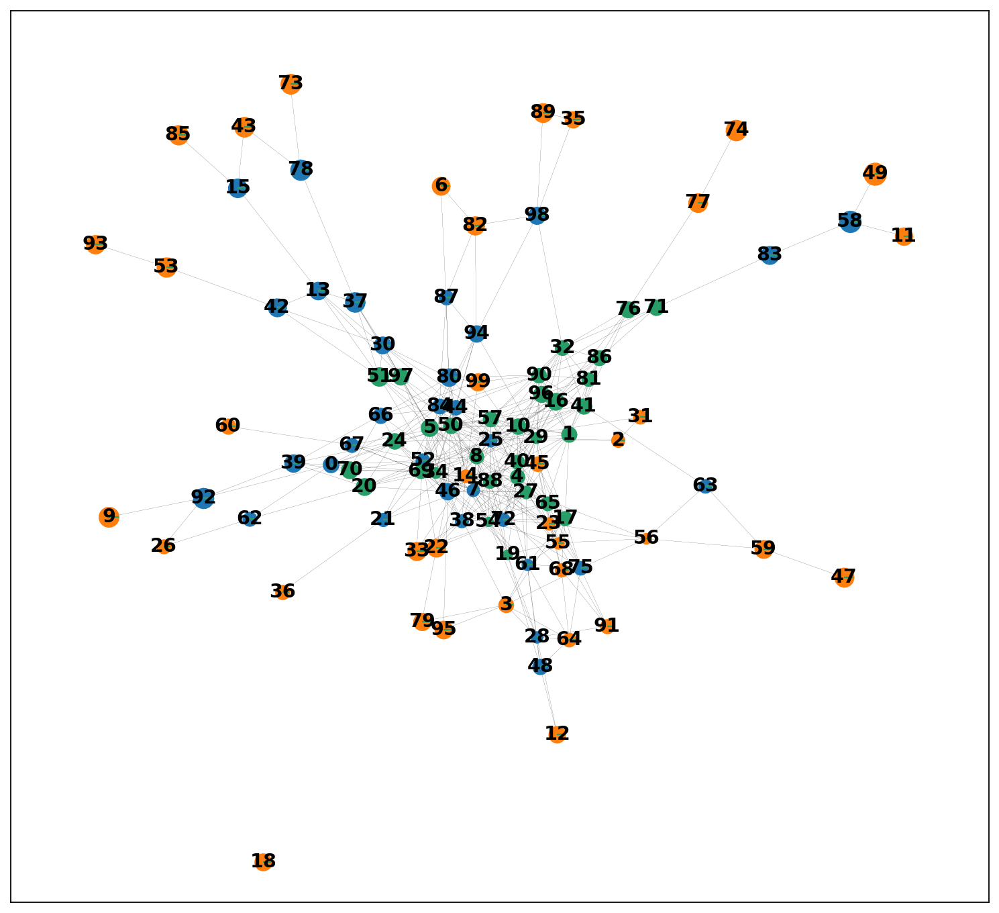

In [103]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
plt.figure(figsize=(10,10))
sc.pl.paga(adep,color='cat_location',threshold=1,edge_width_scale=0.01)

<Figure size 800x800 with 0 Axes>

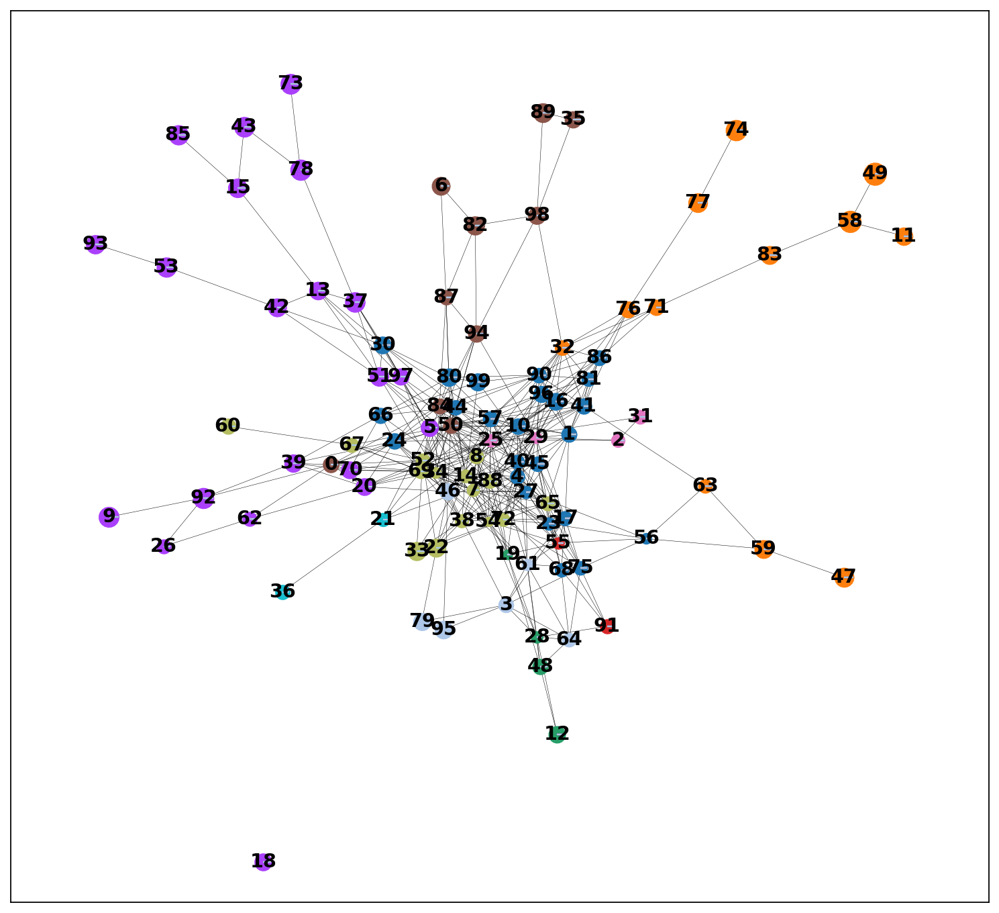

In [106]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
plt.figure(figsize=(10,10))
sc.pl.paga(adep,color='Class',threshold=1,edge_width_scale=0.03)#,show_False)

In [107]:
adep

AnnData object with n_obs × n_vars = 762100 × 3
    obs: 'Unnamed: 0.1', 'Unnamed: 0', 'cell_id', 'overlaps_nucleus', 'feature_name', 'x_location', 'y_location', 'z_location', 'qv', 'initial_annotation', 'initial_annotation_nuclei', 'initial_annotation_cytoplasm', 'kmeans_100', 'kmeans_200', 'kmeans_500', 'read_location', 'location', 'closest_celltype', 'correlated_celltype', 'consistent_related_cluster', 'Class', 'cat_kmeans_100', 'cat_location'
    uns: 'neighbors', 'paga', 'cat_kmeans_100_sizes', 'cat_location_colors', 'Class_colors'
    obsp: 'distances', 'connectivities'

<Figure size 800x800 with 0 Axes>

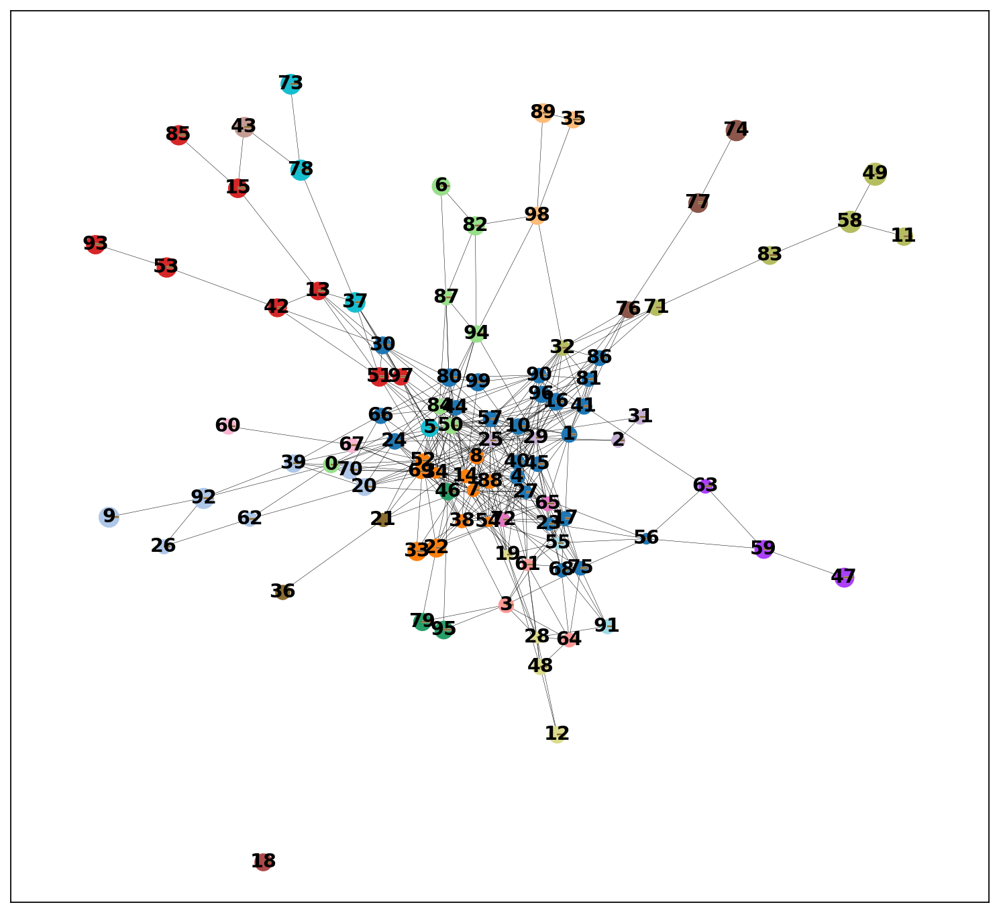

In [108]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
plt.figure(figsize=(10,10))
sc.pl.paga(adep,color='closest_celltype',threshold=1,edge_width_scale=0.03)#,show_False)

In [111]:
adep2=adep[adep.obs['location']!='out']

In [112]:
sc.pp.neighbors(adep2,n_neighbors=3)
adep2.obs['cat_kmeans_100']=adep2.obs['kmeans_100'].astype(str).astype('category')
adep2.obs['cat_location']=adep2.obs['location'].astype(str).astype('category')
sc.tl.paga(adep2,groups='cat_kmeans_100')

<Figure size 800x800 with 0 Axes>

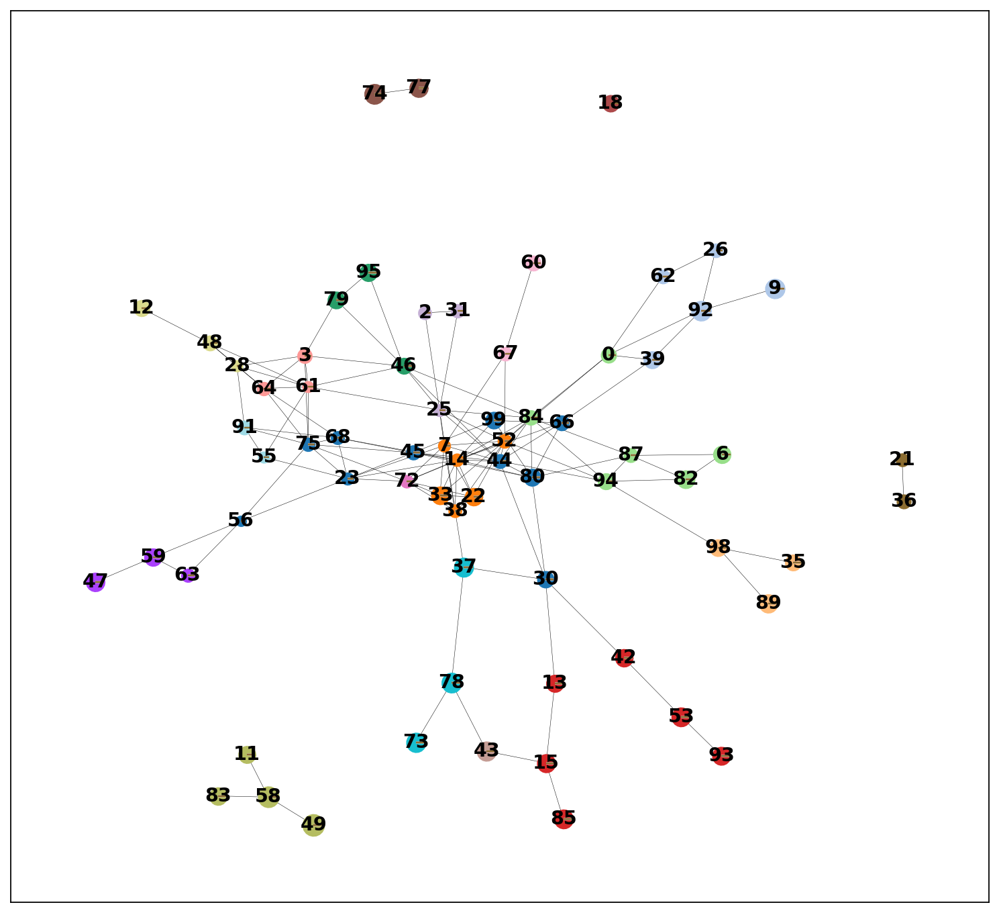

In [121]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,10))
sc.pl.paga(adep2,color='closest_celltype',threshold=1,edge_width_scale=0.03,show=False)
plt.savefig('../../figures/4.fast_kmeans/results/paga_no_out_closest_celltype.pdf')

<Figure size 800x800 with 0 Axes>

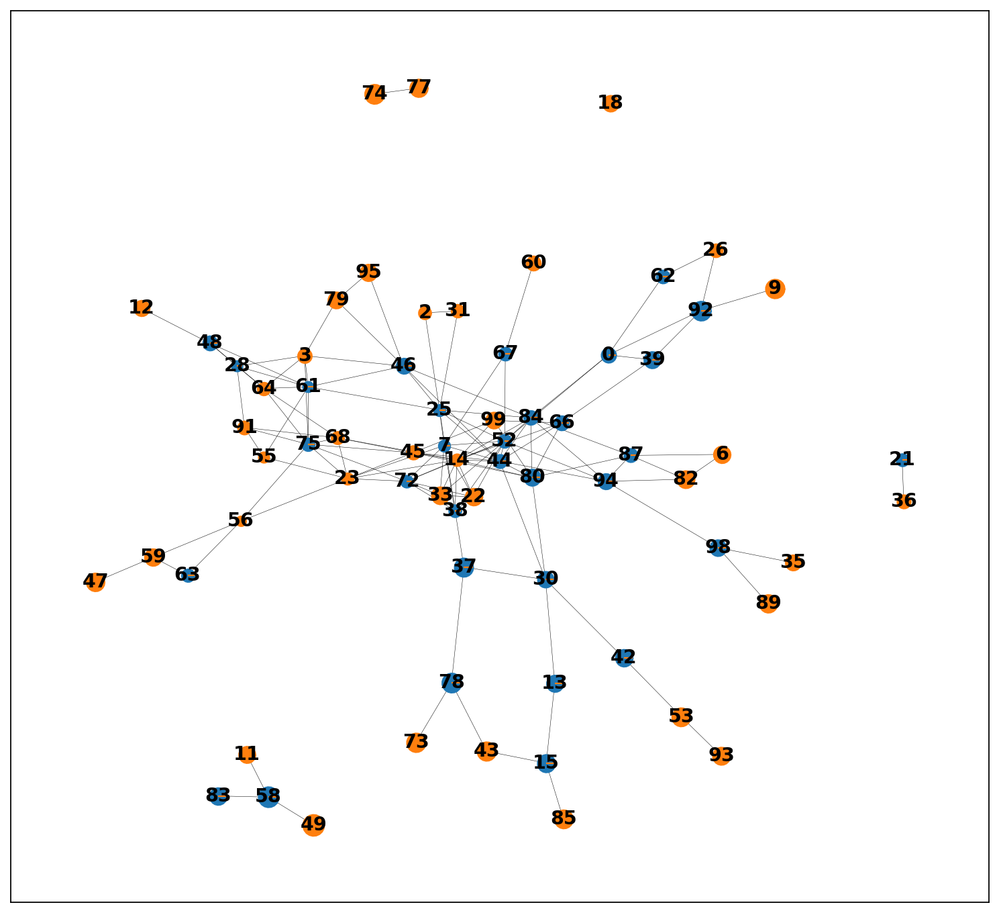

In [122]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,10))
sc.pl.paga(adep2,color='location',threshold=1,edge_width_scale=0.03,show=False)
plt.savefig('../../figures/4.fast_kmeans/results/paga_no_out_closest_location.pdf')

# work with other

In [38]:
reads_original

,transcript_id,cell_id,overlaps_nucleus,feature_name,x_location,y_location,z_location,qv,initial_annotation,initial_annotation_nuclei,...,initial_annotation_cytoplasm,kmeans_100,kmeans_200,kmeans_500,closest_celltype,read_location,location,correlated_celltype,consistent_related_cluster,Class
0,281496451547136,6435,1,NegControlCodeword_0505,47.404972,2041.5103,13.592865,19.736050,12_Inh,8_L6 CT CTX,...,2_L5_5 CTX,37,103,135,8_L6 CT CTX,nuclei,cytoplasm,8_L6 CT CTX,True,Excitatory
1,281496451547138,5788,0,Neurod6,597.499200,1908.6559,13.913390,19.505224,2_CA3,7_CA3,...,6_CA3,11,41,44,7_CA3,cytoplasm,nuclei,7_CA3,True,CA
2,281496451547139,4819,1,Neurod6,596.572800,1062.4052,15.545630,19.797620,2_CA3,7_CA3,...,6_CA3,58,52,405,7_CA3,nuclei,cytoplasm,7_CA3,True,CA
3,281496451547140,5139,1,Dkk3,176.066730,1187.6486,14.824332,19.784027,21_Ependymal,17_Ependymal,...,12_Ependymal,55,95,428,17_Ependymal,nuclei,nuclei,17_Ependymal,True,Ependymal
4,281496451547141,5220,0,Neurod6,608.989800,1246.7114,14.733643,19.737194,2_CA3,7_CA3,...,6_CA3,58,51,108,7_CA3,cytoplasm,cytoplasm,7_CA3,True,CA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7620998,281513631826456,2248,1,Parm1,2903.128700,1953.1665,28.603460,20.588556,4_INH_thalamus,11_INH_thalamus,...,5_Thalamus_2,0,169,274,11_INH_thalamus,nuclei,cytoplasm,9_Excitatory thalamus,False,Inhibitory
7620999,281513631826457,2231,1,Sema6a,2918.454300,1816.0531,29.642420,13.637909,4_INH_thalamus,11_INH_thalamus,...,5_Thalamus_2,35,168,200,10_Inh,nuclei,nuclei,10_Inh,True,Inhibitory
7621000,281513631826458,2231,0,Rasgrf2,2921.778300,1818.0233,29.178177,15.616901,4_INH_thalamus,11_INH_thalamus,...,5_Thalamus_2,35,168,189,10_Inh,cytoplasm,nuclei,10_Inh,True,Inhibitory
7621001,281513631826459,2234,1,Sema6a,2907.748000,1832.5303,29.274850,40.000000,4_INH_thalamus,11_INH_thalamus,...,5_Thalamus_2,6,73,189,11_INH_thalamus,nuclei,nuclei,11_INH_thalamus,True,Inhibitory


In [39]:
reads_subset=reads_original[reads_original['kmeans_100'].isin([26,9,62,92,20,70])]

In [40]:
loci=pd.crosstab(reads_subset['kmeans_100'],reads_subset['feature_name'])

In [41]:
reads_subset

,transcript_id,cell_id,overlaps_nucleus,feature_name,x_location,y_location,z_location,qv,initial_annotation,initial_annotation_nuclei,...,initial_annotation_cytoplasm,kmeans_100,kmeans_200,kmeans_500,closest_celltype,read_location,location,correlated_celltype,consistent_related_cluster,Class
27095,281496451578055,6236,0,Clmn,580.992740,2056.5010,19.058195,40.000000,17_OPC,15_OPC,...,3_CA cells,70,10,174,9_Excitatory thalamus,cytoplasm,out,9_Excitatory thalamus,True,Excitatory
42533,281496451595674,-1,0,Stum,340.004150,1378.9122,17.875465,14.474918,NaN,NaN,...,NaN,70,21,404,9_Excitatory thalamus,out,out,9_Excitatory thalamus,True,Excitatory
51074,281496451605402,6226,0,Sntb1,557.832460,2020.3910,20.128853,22.753353,15_Microglia,13_Microglia,...,3_CA cells,70,156,235,9_Excitatory thalamus,cytoplasm,out,9_Excitatory thalamus,True,Excitatory
59423,281496451614910,-1,0,Nr2f2,340.493100,1378.8726,18.042469,40.000000,NaN,NaN,...,NaN,70,21,404,9_Excitatory thalamus,out,out,9_Excitatory thalamus,True,Excitatory
106598,281496451668689,346,0,Clmn,30.966644,1993.0072,17.858824,40.000000,6_L6 CT CTX,8_L6 CT CTX,...,4_L6 CTX,20,32,404,9_Excitatory thalamus,cytoplasm,out,9_Excitatory thalamus,True,Excitatory
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7620981,281513631826438,18469,0,Nell1,2391.911000,1918.7507,27.549560,30.994420,5_Excitatory thalamus,9_Excitatory thalamus,...,1_Thalamus_1,62,196,327,9_Excitatory thalamus,cytoplasm,cytoplasm,9_Excitatory thalamus,True,Excitatory
7620983,281513631826440,24342,1,Orai2,2804.309300,1933.3575,27.964834,13.411220,4_INH_thalamus,11_INH_thalamus,...,5_Thalamus_2,92,169,274,9_Excitatory thalamus,nuclei,cytoplasm,9_Excitatory thalamus,True,Excitatory
7620991,281513631826449,23769,1,Nell1,2845.297000,1489.3734,28.938150,13.727562,5_Excitatory thalamus,9_Excitatory thalamus,...,1_Thalamus_1,26,148,327,9_Excitatory thalamus,nuclei,nuclei,9_Excitatory thalamus,True,Excitatory
7620994,281513631826452,24439,1,Rasgrf2,2682.374500,1863.7242,28.926102,30.603540,4_INH_thalamus,11_INH_thalamus,...,5_Thalamus_2,9,169,60,9_Excitatory thalamus,nuclei,nuclei,9_Excitatory thalamus,True,Excitatory


In [42]:
loci=loci.loc[:,np.sum(loci,axis=0)>1000]

In [43]:
loci=loci.loc[:,loci.columns.isin(adata.var.index)]
loci=loci.div(loci.sum(axis=1),axis=0)
loci=loci.div(loci.sum(axis=0),axis=1)

In [44]:
list(loci.columns[loci.idxmax()=='cytoplasm'])

[]

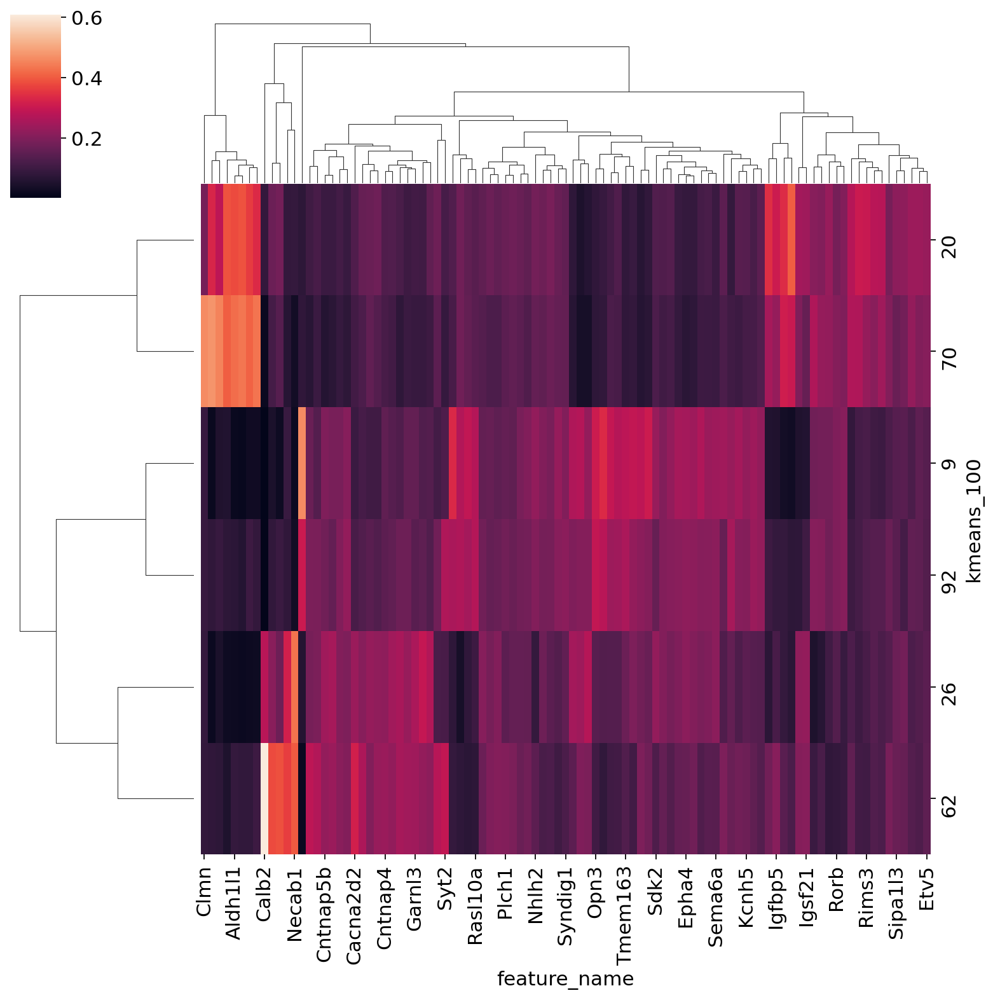

In [260]:
sns.clustermap(loci)

In [45]:
loci=pd.crosstab(reads_original['location'],reads_original['feature_name'])

In [46]:
loci

feature_name,2010300C02Rik,Acsbg1,Acta2,Acvrl1,Adamts2,Adamtsl1,Adgrl4,Aldh1a2,Aldh1l1,Angpt1,...,Trpc4,Tubb2a,Unc13c,Vat1l,Vip,Vwc2l,Wfs1,Zfp366,Zfp536,Zfpm2
location,,,,,,,,,,,,,,,,,,,,,
cytoplasm,28188,39909,1255,2467,1820,1622,5730,977,15648,1684,...,5907,50936,6346,10816,1758,4224,6799,791,10170,4459
nuclei,59775,16419,7761,7736,3517,4762,16148,2572,8994,2204,...,22029,59994,2743,12828,1893,4123,16596,2401,22345,7099
out,38459,34506,1076,732,656,392,1322,370,13899,1238,...,2023,32641,10026,4246,1003,1143,8874,190,6929,1926


In [47]:
loci=loci.loc[:,loci.columns.isin(adata.var.index)]
loci=loci.div(loci.sum(axis=1),axis=0)
loci=loci.div(loci.sum(axis=0),axis=1)

In [48]:
loci

feature_name,2010300C02Rik,Acsbg1,Acta2,Acvrl1,Adamts2,Adamtsl1,Adgrl4,Aldh1a2,Aldh1l1,Angpt1,...,Trpc4,Tubb2a,Unc13c,Vat1l,Vip,Vwc2l,Wfs1,Zfp366,Zfp536,Zfpm2
location,,,,,,,,,,,,,,,,,,,,,
cytoplasm,0.221652,0.387920,0.152079,0.276173,0.347157,0.294131,0.302873,0.294637,0.366760,0.332501,...,0.243817,0.360284,0.273127,0.414893,0.384559,0.480262,0.215258,0.288455,0.282173,0.363498
nuclei,0.326387,0.110822,0.653056,0.601360,0.465837,0.599633,0.592695,0.538604,0.146380,0.302183,...,0.631391,0.294669,0.081978,0.341692,0.287542,0.325517,0.364858,0.607995,0.430509,0.401854
out,0.451961,0.501259,0.194865,0.122467,0.187006,0.106236,0.104432,0.166759,0.486859,0.365316,...,0.124793,0.345048,0.644895,0.243414,0.327900,0.194221,0.419884,0.103550,0.287317,0.234648


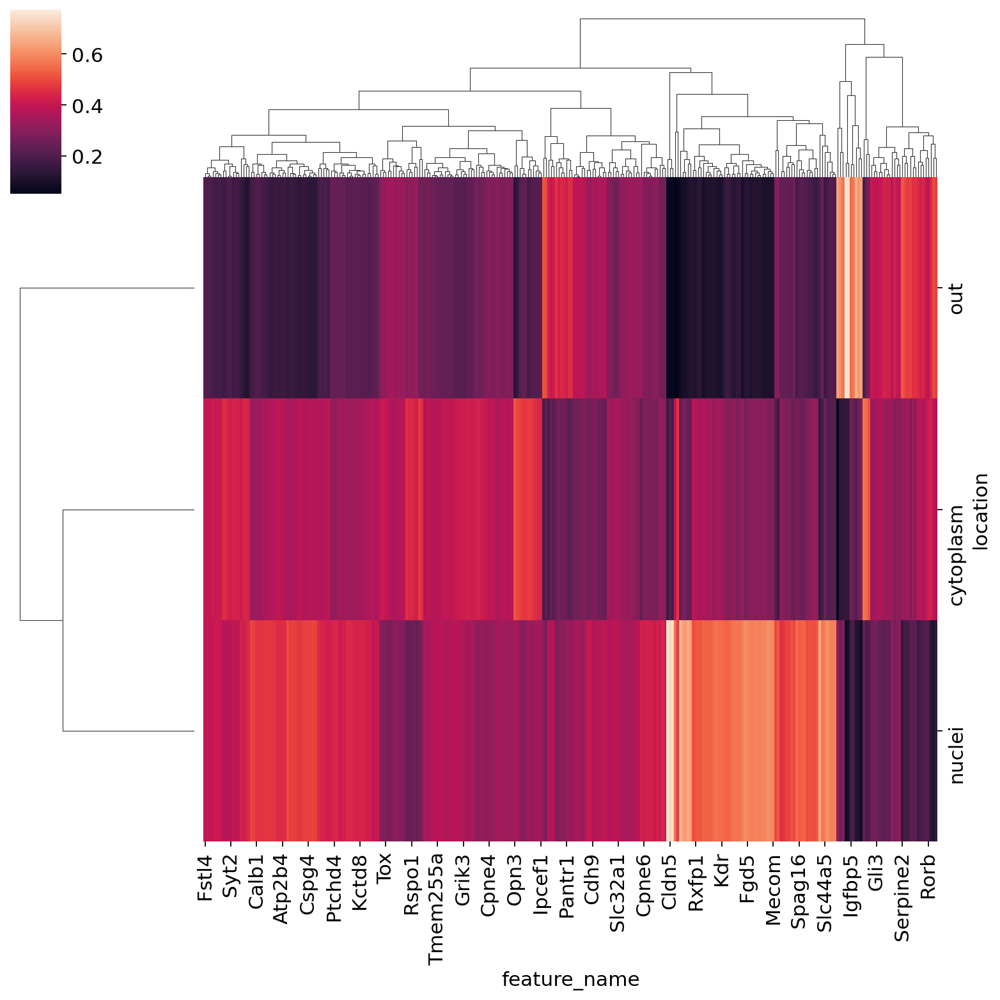

In [273]:
sns.clustermap(loci)

In [279]:
loci.transpose().sort_values(by='nuclei')

location,cytoplasm,nuclei,out
feature_name,,,
Cabp7,0.146899,0.079804,0.773297
Unc13c,0.273127,0.081978,0.644895
Gfap,0.155508,0.096859,0.747633
Acsbg1,0.387920,0.110822,0.501259
Arc,0.262711,0.116125,0.621164
...,...,...,...
Pglyrp1,0.240728,0.654151,0.105122
Cd93,0.236052,0.684196,0.079753
Cldn5,0.204412,0.732945,0.062642


# explore domain

In [50]:
reads_original.to_csv('../../data/celltyping_csv/kmeans_sample2_nuclei_annotation.csv')

In [71]:
reads_original=pd.read_csv('../../data/celltyping_csv/kmeans_sample2_nuclei_annotation.csv')

In [72]:
reads_assigned=reads_original

In [73]:
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation.h5ad')

In [74]:
#adata.layers['raw']=adata.layers['raw'].X

In [75]:
sample1_region=pd.read_csv('../../figures/7.spatial_architecture/Spatial_annotation_transcript_2.csv')

In [76]:
sample1_region.shape

(9496065, 2)

In [77]:
transcript2region=dict(zip(sample1_region.index,sample1_region['x']))

In [78]:
adata1=adata[adata.obs['replicate']=='2']

In [79]:
reads_assigned['Unnamed: 0']=reads_assigned['ind']

In [80]:
reads_assigned['domain']=reads_assigned['Unnamed: 0'].map(transcript2region)

In [81]:
reads_assigned.shape

(8866360, 22)

In [82]:
#reads_assigned['domain']=reads_assigned['cell_id'].map(cell2region_sample1)
reads_not_assigned=reads_assigned[reads_assigned['cell_id']==-1]
reads_assigned=reads_assigned[reads_assigned['cell_id']!=-1]

In [83]:
reads_assigned.shape

(8391888, 22)

In [84]:
cells_metadata=adata1.obs
cells_metadata_filt=cells_metadata.loc[cells_metadata['cell_id'].isin(reads_assigned['cell_id']),:]
def distance_calc (x1,y1,x2,y2):
    import math
    distance = math.sqrt( ((x1-x2)**2)+((y1-y2)**2) )
    return(distance)
reads_assigned=reads_assigned[reads_assigned['cell_id'].isin(cells_metadata_filt['cell_id'])]

In [85]:
dictx=dict(zip(cells_metadata_filt['cell_id'],cells_metadata_filt['x_centroid']))
dicty=dict(zip(cells_metadata_filt['cell_id'],cells_metadata_filt['y_centroid']))
reads_assigned['x_cell']=list(reads_assigned['cell_id'].map(dictx))
reads_assigned['y_cell']=list(reads_assigned['cell_id'].map(dicty))

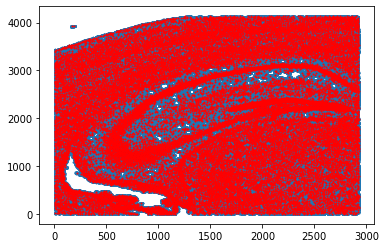

In [86]:
plt.scatter(reads_assigned['x_location'],reads_assigned['y_location'],s=1)
plt.scatter(cells_metadata['x_centroid'],cells_metadata['y_centroid'],s=1,color='red')

In [87]:
dist2=(reads_assigned['x_location']-reads_assigned['x_cell'])**2+(reads_assigned['y_location']-reads_assigned['y_cell'])**2
reads_assigned['distance']=np.sqrt(dist2)

In [88]:
reads_assigned['distance']=reads_assigned['distance'].round(0)

In [90]:
reads_assigned.to_csv('../../data/celltyping_csv/kmeans_sample2_nuclei_annotation_assigned.csv')
#reads_original.to_csv('../../data/celltyping_csv/kmeans_sample2_nuclei_annotation.csv')

In [69]:
background_express=pd.crosstab(reads_not_assigned['domain'],reads_not_assigned['feature_name'])

In [67]:
def dist_nuc(reads_ctdsub):
    from scipy.spatial import ConvexHull, convex_hull_plot_2d
    allds=[]
    for g,n in reads_ctdsub.groupby('cell_id'):
        try:
            hull = ConvexHull(np.array(n.loc[:,['x_location','y_location']]))
            allds.append(np.mean(n.iloc[hull.vertices]['distance']))
        except:
            print()
    return np.median(allds)

Ependymal





CA2_3














L6 CT Syt6





Car4+ EC



















/tmp/ipykernel_113/1754122413.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
















L4_5 IT









Oligo



















































































































Pericytes




Lamp5 INH
Sst INH


Astro1






























Astro2























Microglia













CA1















Pvalb INH




KeyboardInterrupt: 

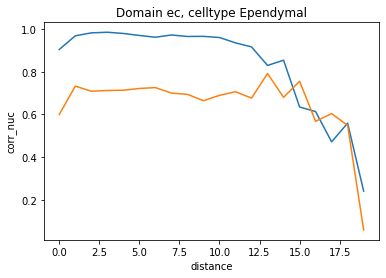

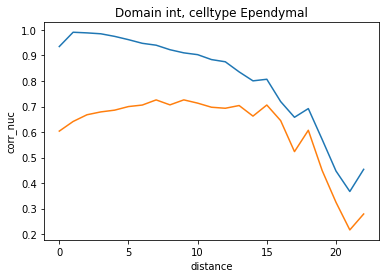

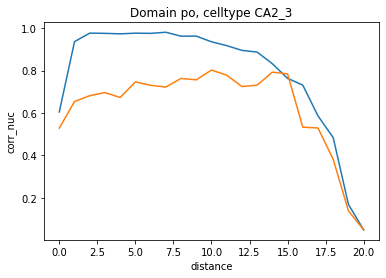

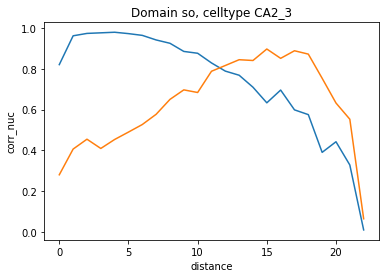

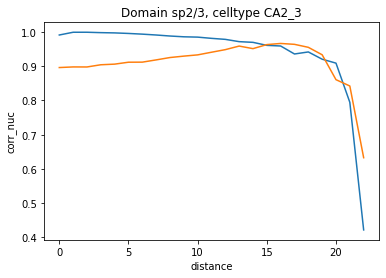

...

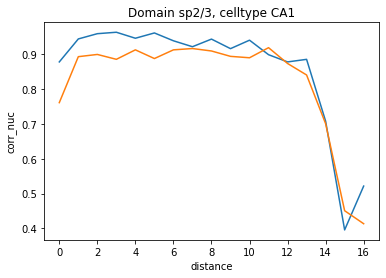

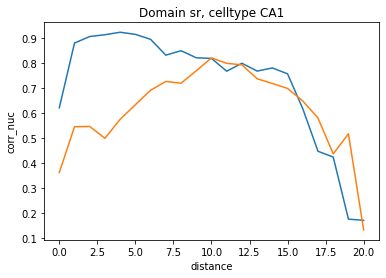

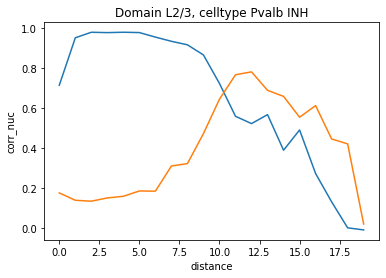

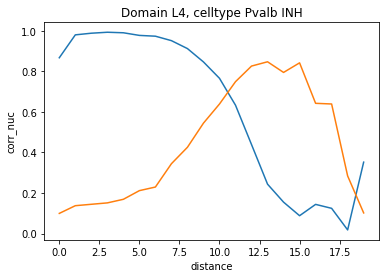

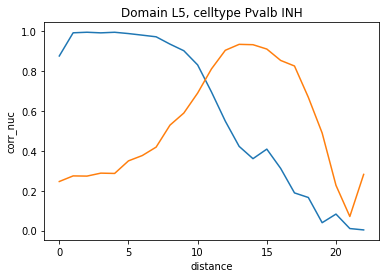

In [70]:
turnover_summ=pd.DataFrame(columns=reads_assigned['initial_annotation'].unique(),index=reads_assigned['domain'].unique())
meand_celltype=[]
nuclimall=[]
cellmall=[]
for CELLTYPE in reads_assigned['initial_annotation'].unique():
    print(CELLTYPE)
    reads_assignedsub=reads_assigned[reads_assigned['initial_annotation']==CELLTYPE]
    good_domains=reads_assignedsub.groupby('domain').count()[reads_assignedsub.groupby('domain').count().iloc[:,1]>5000].index
    tdistanceall=[]
    nuclim=[]
    cellm=[]
    for dom in good_domains:
        reads_ctd=reads_assignedsub[reads_assignedsub['domain']==dom]
        expression_distances=pd.crosstab(reads_ctd['distance'],reads_ctd['feature_name'])
        reads_ctd_nucl=pd.crosstab(reads_ctd['overlaps_nucleus'],reads_ctd['feature_name'])
        reads_ctd_nucl=reads_ctd_nucl.loc[:,reads_ctd_nucl.columns.isin(background_express.columns)]
        reads_ctd_nucl=reads_ctd_nucl.sort_values(by='feature_name', axis=1)
        bck_sub=background_express.loc[:,background_express.columns.isin(reads_ctd_nucl.columns)]
        bck_sub=bck_sub.sort_values(by='feature_name', axis=1)
        expression_distances=expression_distances.loc[:,expression_distances.columns.isin(reads_ctd_nucl.columns)]
        expression_distances=expression_distances.sort_values(by='feature_name', axis=1)
        corr_nuc=[]
        corr_bck=[]
        for dist in expression_distances.index:
            corr_bck.append(np.corrcoef(expression_distances.loc[dist,:],bck_sub.loc[dom,:])[0,1])
            corr_nuc.append(np.corrcoef(expression_distances.loc[dist,:],reads_ctd_nucl.loc[1,:])[0,1])
        summary=pd.DataFrame([corr_nuc,corr_bck],columns=expression_distances.index,index=['corr_nuc','corr_back']).transpose()
        summary['corr_nuc']=summary['corr_nuc'].astype(float)
        summary['diff']=summary['corr_nuc']-summary['corr_back']
        plt.figure()
        sns.lineplot(data=summary,x='distance',y='corr_nuc')
        sns.lineplot(data=summary,x='distance',y='corr_back')
        plt.title('Domain '+str(dom)+', celltype ' + str(CELLTYPE) )
        try:
            tdistance=np.min(summary.loc[summary['diff']<0,:].index)
        except:
            tdistance=np.max(summary.index)
        if str(np.min(summary.loc[summary['diff']<0.1,:].index))=='nan':
            tdistance=np.max(summary.index)
        turnover_summ.loc[dom,CELLTYPE]=tdistance
        tdistanceall.append(tdistance)
        reads_ctdsub=reads_ctd[reads_ctd['overlaps_nucleus']==1]
        cellm.append(dist_nuc(reads_ctd))
        nuclim.append(dist_nuc(reads_ctdsub))
    meand_celltype.append(np.mean(tdistanceall))
    nuclimall.append(np.mean(nuclim))
    cellmall.append(np.mean(cellm))

L6 CT Syt6





CA2_3








Ependymal






































Microglia




/tmp/ipykernel_321/2351020268.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()











Sst INH

Astro1








































L6b CTX







Astro2































Oligo

































































































CA1











Car4+ EC
























Vip INH

Pvalb INH

OPC











Perivascular_macrophages
Lamp5 INH




L4_5 IT














Pericytes











Cck INH
COP

INH Thal 3

Car4- EC








Car3 EXC
L5_6_IT



Meis2 INH
L2_3 IT





L5 PT
L5 NP
Hippoth EXC






L5 IT 
L4 IT

VLMC


DG








Caudoputamen EXC
Hippoc INH


CP




Cajal Retzius

Granule neuroblasts (DG)









INH Thal 2




Thalamic EXC

INH Thal 1


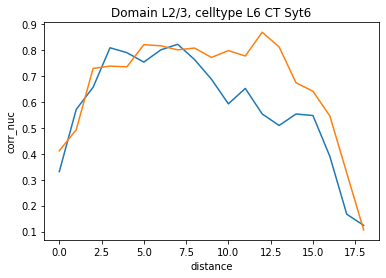

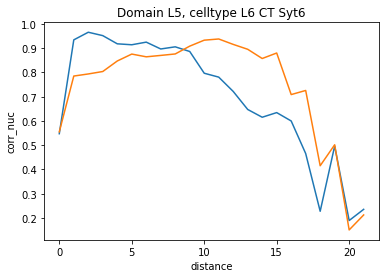

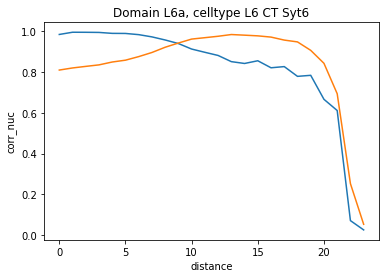

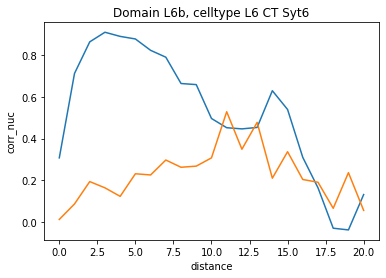

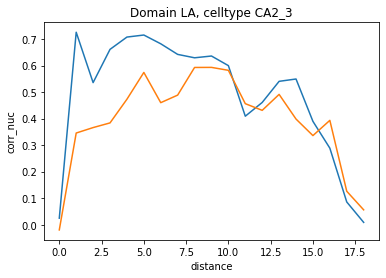

...

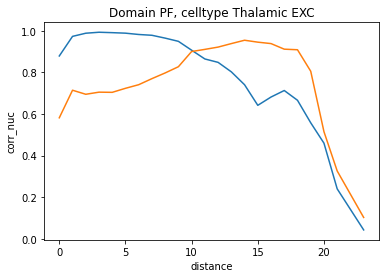

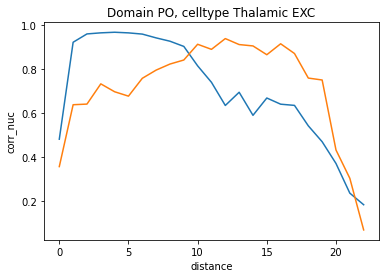

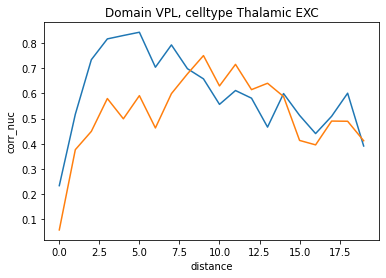

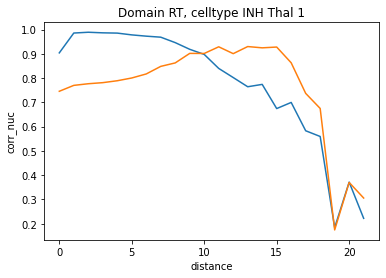

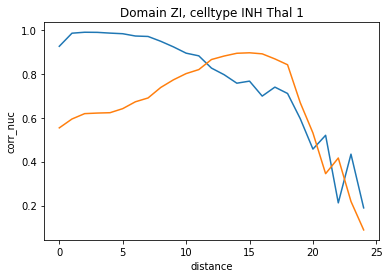

In [64]:
turnover_summ=pd.DataFrame(columns=reads_assigned['initial_annotation'].unique(),index=reads_assigned['domain'].unique())
meand_celltype=[]
nuclimall=[]
cellmall=[]
for CELLTYPE in reads_assigned['initial_annotation'].unique():
    print(CELLTYPE)
    reads_assignedsub=reads_assigned[reads_assigned['initial_annotation']==CELLTYPE]
    good_domains=reads_assignedsub.groupby('domain').count()[reads_assignedsub.groupby('domain').count().iloc[:,1]>1000].index
    tdistanceall=[]
    nuclim=[]
    cellm=[]
    for dom in good_domains:
        reads_ctd=reads_assignedsub[reads_assignedsub['domain']==dom]
        expression_distances=pd.crosstab(reads_ctd['distance'],reads_ctd['feature_name'])
        reads_ctd_nucl=pd.crosstab(reads_ctd['overlaps_nucleus'],reads_ctd['feature_name'])
        reads_ctd_nucl=reads_ctd_nucl.loc[:,reads_ctd_nucl.columns.isin(background_express.columns)]
        reads_ctd_nucl=reads_ctd_nucl.sort_values(by='feature_name', axis=1)
        bck_sub=background_express.loc[:,background_express.columns.isin(reads_ctd_nucl.columns)]
        bck_sub=bck_sub.sort_values(by='feature_name', axis=1)
        expression_distances=expression_distances.loc[:,expression_distances.columns.isin(reads_ctd_nucl.columns)]
        expression_distances=expression_distances.sort_values(by='feature_name', axis=1)
        corr_nuc=[]
        corr_bck=[]
        for dist in expression_distances.index:
            corr_bck.append(np.corrcoef(expression_distances.loc[dist,:],bck_sub.loc[dom,:])[0,1])
            corr_nuc.append(np.corrcoef(expression_distances.loc[dist,:],reads_ctd_nucl.loc[1,:])[0,1])
        summary=pd.DataFrame([corr_nuc,corr_bck],columns=expression_distances.index,index=['corr_nuc','corr_back']).transpose()
        summary['corr_nuc']=summary['corr_nuc'].astype(float)
        summary['diff']=summary['corr_nuc']-summary['corr_back']
        plt.figure()
        import matplotlib
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.lineplot(data=summary,x='distance',y='corr_nuc')
        sns.lineplot(data=summary,x='distance',y='corr_back')
        plt.title('Domain '+str(dom)+', celltype ' + str(CELLTYPE) )
        plt.savefig('../../figures/celltype_identification_mscoronal/crossover_point/'+str(dom.replace('/','_'))+'_'+str(CELLTYPE)+'.pdf')
        try:
            tdistance=np.min(summary.loc[summary['diff']<0.1,:].index)
        except:
            tdistance=np.max(summary.index)
        if str(np.min(summary.loc[summary['diff']<0.1,:].index))=='nan':
            tdistance=np.max(summary.index)
        turnover_summ.loc[dom,CELLTYPE]=tdistance
        tdistanceall.append(tdistance)
        reads_ctdsub=reads_ctd[reads_ctd['overlaps_nucleus']==1]
        cellm.append(dist_nuc(reads_ctd))
        nuclim.append(dist_nuc(reads_ctdsub))
    meand_celltype.append(np.mean(tdistanceall))
    nuclimall.append(np.mean(nuclim))
    cellmall.append(np.mean(cellm))

In [ ]:
turnover_x_celltype=pd.DataFrame([meand_celltype,nuclimall,cellmall],columns=reads_assigned['initial_annotation'].unique(),index=['turnover','nuclei_size','cell_size'])

In [ ]:
turnover_x_celltype=turnover_x_celltype.fillna(0).transpose()
#turnover_x_celltype['cell_size']=turnover_x_celltype['nuclei_size']+15
turnover_x_celltype=turnover_x_celltype.sort_values(by='turnover')

In [ ]:
adatanuc=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation_with_colors.h5ad')

In [ ]:
coldict=dict(zip(np.unique(adatanuc.obs['celltype_annotation']),adatanuc.uns['celltype_annotation_colors']))
cldict=dict(zip(adatanuc.obs['initial_annotation'],adatanuc.obs['celltype_annotation']))
turnover_x_celltype['colors']=turnover_x_celltype.index.map(cldict).map(coldict)
tf=turnover_x_celltype.iloc[1:,:]

In [ ]:
def hex_to_rgb(value):
    value = value.lstrip('#')
    lv = len(value)
    return tuple(int(value[i:i + lv // 3], 16) for i in range(0, lv, lv // 3))

In [ ]:
tf

<AxesSubplot:xlabel='nuclei_size'>

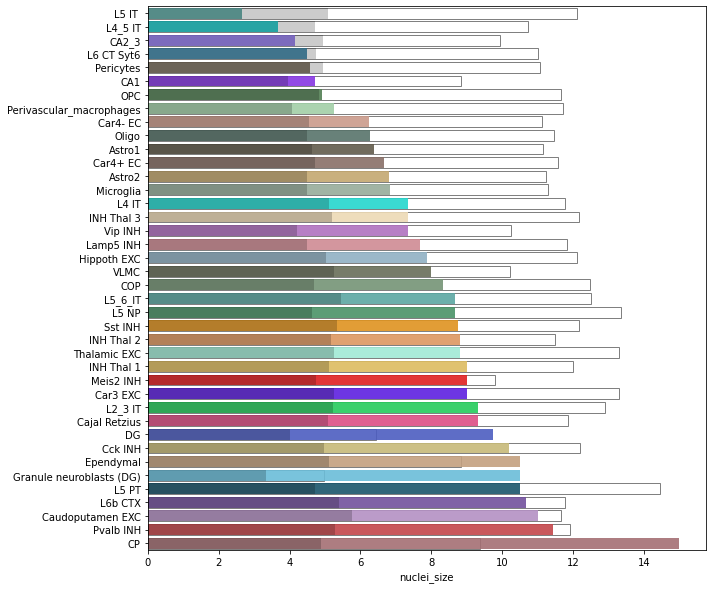

In [71]:
plt.figure(figsize=(10,10))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ax=sns.barplot(data=tf,y=tf.index,x='cell_size',edgecolor='gray',color='white')
plt.setp(ax.patches, linewidth=1)
sns.barplot(data=tf,y=tf.index,x='turnover',palette=tf.colors,alpha=0.9)
sns.barplot(data=tf,y=tf.index,x='nuclei_size',color='black',alpha=0.2)

<AxesSubplot:xlabel='nuclei_size'>

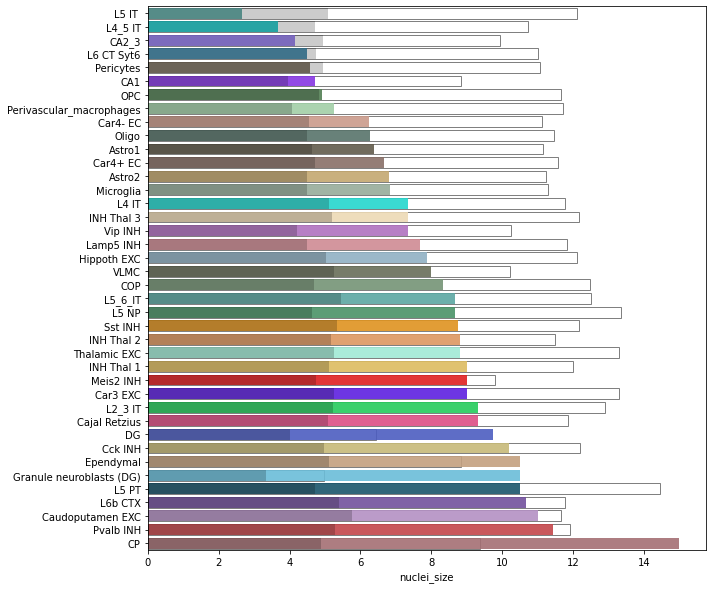

In [72]:
plt.figure(figsize=(10,10))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
ax=sns.barplot(data=tf,y=tf.index,x='cell_size',edgecolor='gray',color='white')
plt.setp(ax.patches, linewidth=1)
sns.barplot(data=tf,y=tf.index,x='turnover',palette=tf.colors,alpha=0.9)
sns.barplot(data=tf,y=tf.index,x='nuclei_size',color='black',alpha=0.2)

In [75]:
reg_mean=[]
#del tball
for ind in turnover_summ.columns:
    reg_mean.append(np.mean(turnover_summ.loc[:,ind]))
    tb=pd.DataFrame(turnover_summ.loc[:,ind])
    tb.columns=['to']
    tb['ct']=ind
    tb.reset_index()
    try:
        tball=pd.concat([tball,tb],axis=0)
    except:
        tball=tb

In [76]:
tf['cluster']=tf.index
tball.columns=['score','cluster']
tfmerge=tball.merge(on='cluster',right=tf)
tfmerge=tfmerge.sort_values(by='turnover')

/tmp/ipykernel_321/654446311.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tf['cluster']=tf.index


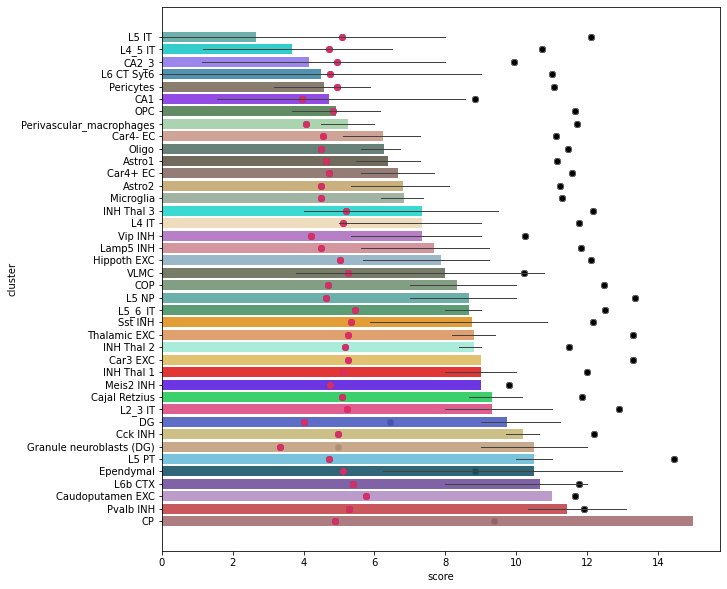

In [78]:
plt.figure(figsize=(10,10))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
#ax=sns.barplot(data=tfmerge,y=tfmerge.cluster,x='cell_size',edgecolor='gray',color='white')
sns.scatterplot(data=tfmerge,y=tfmerge.cluster,x='cell_size',edgecolor='gray',color='black')
plt.setp(ax.patches, linewidth=1)
sns.barplot(data=tfmerge,y=tfmerge.cluster,x='score',palette=tf.colors,alpha=0.9,errwidth=1)
sns.scatterplot(data=tfmerge,y=tfmerge.cluster,x='nuclei_size',color='#D83066',edgecolor=None,alpha=0.2)
#sns.barplot(data=tfmerge,y=tfmerge.cluster,x='nuclei_size',color='black',alpha=0.2)
plt.savefig('../../figures/celltype_identification_mscoronal_nuclei/nuclei_vs_background_0_crossover.pdf')

In [87]:
tfmerge

,score,cluster,turnover,nuclei_size,cell_size,colors
1079,NaN,L5 IT,2.666667,5.087903,12.107407,#50B2AD
1058,NaN,L5 IT,2.666667,5.087903,12.107407,#50B2AD
1057,NaN,L5 IT,2.666667,5.087903,12.107407,#50B2AD
1056,NaN,L5 IT,2.666667,5.087903,12.107407,#50B2AD
1055,NaN,L5 IT,2.666667,5.087903,12.107407,#50B2AD
...,...,...,...,...,...,...
1244,NaN,CP,15.000000,4.875000,9.363636,#ad666c
1243,NaN,CP,15.000000,4.875000,9.363636,#ad666c
1241,NaN,CP,15.000000,4.875000,9.363636,#ad666c
1248,NaN,CP,15.000000,4.875000,9.363636,#ad666c


In [100]:
tfmerge_sel=tfmerge.groupby('cluster').count()['score'][tfmerge.groupby('cluster').count()['score']>5].index
tfmergesub=tfmerge[tfmerge['cluster'].isin(tfmerge_sel)]
tfsub=tf[tf.index.isin(tfmerge_sel)]

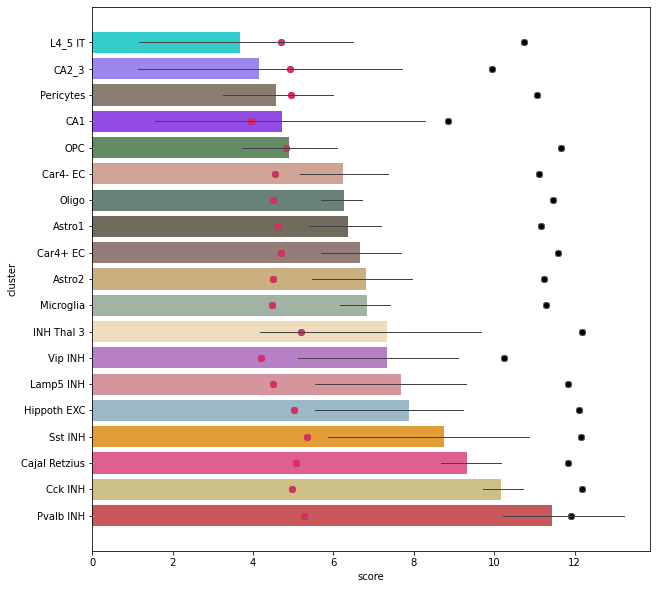

In [101]:
plt.figure(figsize=(10,10))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
#ax=sns.barplot(data=tfmerge,y=tfmerge.cluster,x='cell_size',edgecolor='gray',color='white')
sns.scatterplot(data=tfmergesub,y=tfmergesub.cluster,x='cell_size',edgecolor='gray',color='black')
plt.setp(ax.patches, linewidth=1)
sns.barplot(data=tfmergesub,y=tfmergesub.cluster,x='score',palette=tfsub.colors,alpha=0.9,errwidth=1)
sns.scatterplot(data=tfmergesub,y=tfmergesub.cluster,x='nuclei_size',color='#D83066',edgecolor=None,alpha=0.2)
#sns.barplot(data=tfmerge,y=tfmerge.cluster,x='nuclei_size',color='black',alpha=0.2)
plt.savefig('../../figures/celltype_identification_mscoronal_nuclei/nuclei_vs_background_0_crossover_subset_5domains_min.pdf')

In [3]:
domain_level=pd.read_csv("../../data/annotation_dictionaries/ABA_domain_annotation_dictionary.csv",sep=';')
domain_color_dict=dict(zip(domain_level['level5'],domain_level['color']))
reads_assigned['domain_color']=reads_assigned['domain'].map(domain_color_dict)

NameError: name 'reads_assigned' is not defined

In [80]:
reads_domain=reads_assigned.loc[~reads_assigned['domain_color'].isna()]

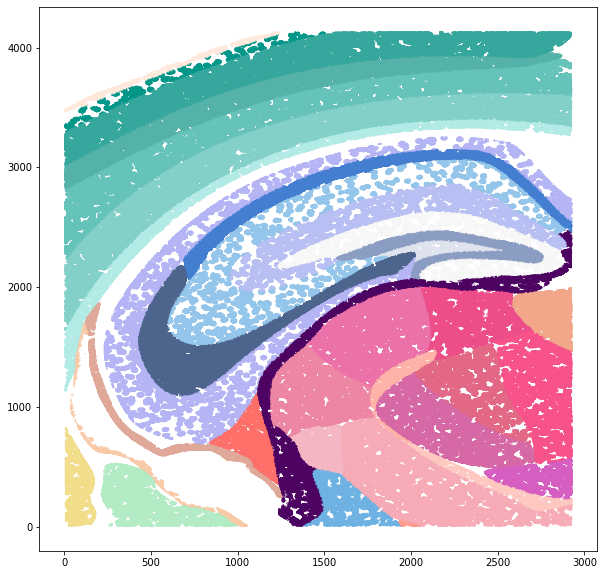

In [81]:
plt.figure(figsize=(10,10))
plt.scatter(reads_domain['x_location'],reads_domain['y_location'],c=reads_domain['domain_color'],s=0.1)

In [94]:
reads_domain.to_csv('../../data/celltyping_csv/kmeans_sample1_domain.csv')

In [8]:
reads_assigned=reads_domain

In [7]:
reads_domain=pd.read_csv('../../data/celltyping_csv/kmeans_sample1_nuclei_annotation.csv')

In [26]:
reads_assigned['distance']=reads_assigned['distance'].astype(int)

<AxesSubplot:xlabel='score', ylabel='cluster'>

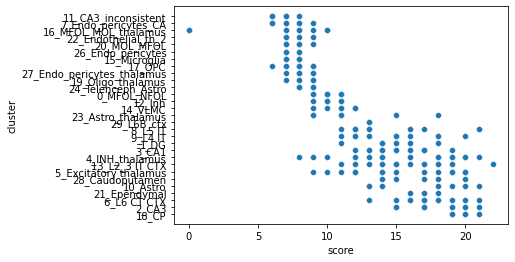

In [463]:
sns.scatterplot(data=tfmerge,y=tfmerge['cluster'],x=tfmerge['score'])#,palette=tball['ct'].map(coldict),alpha=0.9)

In [277]:
reg_mean=[]
for ind in turnover_summ.index:
    reg_mean.append(np.mean(turnover_summ.loc[ind,:]))

In [281]:
domain_turnover=pd.DataFrame([reg_mean],columns=turnover_summ.index,index=['domain_mean']).transpose()

<AxesSubplot:xlabel='domain_mean'>

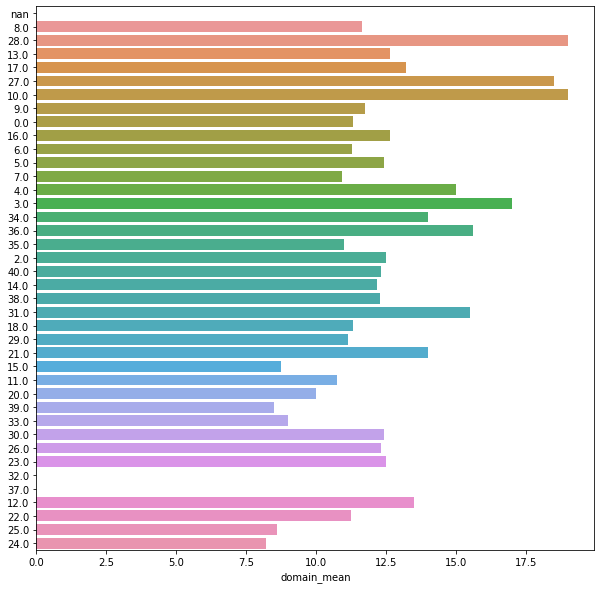

In [285]:
plt.figure(figsize=(10,10))
sns.barplot(data=domain_turnover,y=domain_turnover.index.astype(str),x='domain_mean')

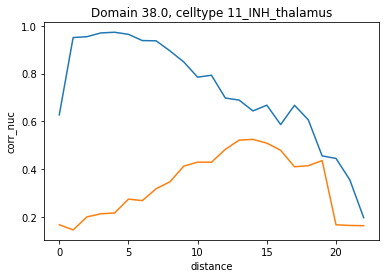

In [202]:
reads_ctd=reads_assignedsub[reads_assignedsub['domain']==dom]
expression_distances=pd.crosstab(reads_ctd['distance'],reads_ctd['feature_name'])
reads_ctd_nucl=pd.crosstab(reads_ctd['overlaps_nucleus'],reads_ctd['feature_name'])
reads_ctd_nucl=reads_ctd_nucl.loc[:,reads_ctd_nucl.columns.isin(background_express.columns)]
reads_ctd_nucl=reads_ctd_nucl.sort_values(by='feature_name', axis=1)
bck_sub=background_express.loc[:,background_express.columns.isin(reads_ctd_nucl.columns)]
bck_sub=bck_sub.sort_values(by='feature_name', axis=1)
expression_distances=expression_distances.loc[:,expression_distances.columns.isin(reads_ctd_nucl.columns)]
expression_distances=expression_distances.sort_values(by='feature_name', axis=1)
corr_nuc=[]
corr_bck=[]
for dist in expression_distances.index:
    corr_bck.append(np.corrcoef(expression_distances.loc[dist,:],bck_sub.loc[dom,:])[0,1])
    corr_nuc.append(np.corrcoef(expression_distances.loc[dist,:],reads_ctd_nucl.loc[1,:])[0,1])
summary=pd.DataFrame([corr_nuc,corr_bck],columns=expression_distances.index,index=['corr_nuc','corr_back']).transpose()
summary['corr_nuc']=summary['corr_nuc'].astype(float)
summary['diff']=summary['corr_nuc']-summary['corr_back']
plt.figure()
sns.lineplot(data=summary,x='distance',y='corr_nuc')
sns.lineplot(data=summary,x='distance',y='corr_back')
plt.title('Domain '+str(dom)+', celltype ' + str(CELLTYPE) )
try:
    tdistance=np.min(summary.loc[summary['diff']<0.1,:].index)
except:
    tdistance=np.max(summary.index)
np.percentile(reads_ctd.loc[reads_ctd['overlaps_nucleus']==1,'distance'],95)
tdistanceall.append(tdistance)
meand_celltype.append(np.mean(tdistanceall))

9.0

# Save for Louis

In [2]:
# get reads original
adata1=sc.read('../../data/unprocessed_adata/ms_brain_rep1.h5ad')
reads_original=adata1.uns['spots']
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters.h5ad')
adata1=adata[adata.obs['replicate']=='1']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation']=reads_original['cell_id'].map(id_cluster)
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation_with_colors.h5ad')
adata1=adata[adata.obs['replicate']=='1']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation_nuclei']=reads_original['cell_id'].map(id_cluster)

In [3]:
reads_original

,cell_id,overlaps_nucleus,feature_name,x_location,y_location,z_location,qv,initial_annotation,initial_annotation_nuclei
transcript_id,,,,,,,,,
281496451547136,6435,1,NegControlCodeword_0505,47.404972,2041.5103,13.592865,19.736050,12_Inh,L6 CT Syt6
281496451547137,252,0,Sox10,7.492498,1074.2043,14.628445,19.876242,15_Microglia,Microglia
281496451547138,5788,0,Neurod6,597.499200,1908.6559,13.913390,19.505224,2_CA3,CA2_3
281496451547139,4819,1,Neurod6,596.572800,1062.4052,15.545630,19.797620,2_CA3,CA2_3
281496451547140,5139,1,Dkk3,176.066730,1187.6486,14.824332,19.784027,21_Ependymal,Ependymal
...,...,...,...,...,...,...,...,...,...
281513631826456,2248,1,Parm1,2903.128700,1953.1665,28.603460,20.588556,4_INH_thalamus,Cajal Retzius
281513631826457,2231,1,Sema6a,2918.454300,1816.0531,29.642420,13.637909,4_INH_thalamus,INH Thal 2
281513631826458,2231,0,Rasgrf2,2921.778300,1818.0233,29.178177,15.616901,4_INH_thalamus,INH Thal 2


In [4]:
annotation=pd.read_csv(r"../../data/annotation_dictionaries/number_to_annotation_updated_cluster_3rep_only_nuclei.csv",sep=';')
cluster06_initialannotation=dict(zip(annotation['cluster_0_6'],annotation['original_annotation']))
cluster06_Class=dict(zip(annotation['cluster_0_6'],annotation['Class']))
adata.obs['Class']=adata.obs['leiden_0_6'].astype(int).map(cluster06_Class)
adata.obs['initial_annotation']=adata.obs['leiden_0_6'].astype(str)+'_'+adata.obs['leiden_0_6'].astype(int).map(cluster06_initialannotation)
adata.obs['celltype_annotation']=adata.obs['leiden_0_6'].astype(int).map(cluster06_initialannotation)
adata.obs['cell_code']=list(adata.obs['cell_id'].astype(str)+'_'+adata.obs['replicate'].astype(str))
cluster06_scRNAseq=dict(zip(annotation['cluster_0_6'],annotation['Matching scRNAseq']))

In [5]:
adata.obs['Matching_scrnaseq']=list(adata.obs['leiden_0_6'].astype(int).map(cluster06_scRNAseq))
dici=dict(zip(adata.obs['initial_annotation'],adata.obs['Matching_scrnaseq']))
cs=reads_original
cs['matching_scrnaseq']=cs['initial_annotation_nuclei'].map(dici)

In [6]:
cs_rep1=cs.loc[:,['cell_id','initial_annotation_nuclei','matching_scrnaseq']]
cs_rep1.to_csv('../../data/celltyping_csv/reads_to_ref_scRNAseq_cluster_sample1_nuclei.csv')

# Replicate 2

In [9]:
# get reads original
adata1=sc.read('../../data/unprocessed_adata/ms_brain_rep2.h5ad')
reads_original=adata1.uns['spots']
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters.h5ad')
adata1=adata[adata.obs['replicate']=='2']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation']=reads_original['cell_id'].map(id_cluster)
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation_with_colors.h5ad')
adata1=adata[adata.obs['replicate']=='2']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation_nuclei']=reads_original['cell_id'].map(id_cluster)

In [10]:
annotation=pd.read_csv(r"../../data/annotation_dictionaries/number_to_annotation_updated_cluster_3rep_only_nuclei.csv",sep=';')
cluster06_initialannotation=dict(zip(annotation['cluster_0_6'],annotation['original_annotation']))
cluster06_Class=dict(zip(annotation['cluster_0_6'],annotation['Class']))
adata.obs['Class']=adata.obs['leiden_0_6'].astype(int).map(cluster06_Class)
adata.obs['initial_annotation']=adata.obs['leiden_0_6'].astype(str)+'_'+adata.obs['leiden_0_6'].astype(int).map(cluster06_initialannotation)
adata.obs['celltype_annotation']=adata.obs['leiden_0_6'].astype(int).map(cluster06_initialannotation)
adata.obs['cell_code']=list(adata.obs['cell_id'].astype(str)+'_'+adata.obs['replicate'].astype(str))
cluster06_scRNAseq=dict(zip(annotation['cluster_0_6'],annotation['Matching scRNAseq']))
adata.obs['Matching_scrnaseq']=list(adata.obs['leiden_0_6'].astype(int).map(cluster06_scRNAseq))
dici=dict(zip(adata.obs['initial_annotation'],adata.obs['Matching_scrnaseq']))
cs=reads_original
cs['matching_scrnaseq']=cs['initial_annotation_nuclei'].map(dici)
cs_rep2=cs.loc[:,['cell_id','initial_annotation_nuclei','matching_scrnaseq']]
cs_rep2.to_csv('../../data/celltyping_csv/reads_to_ref_scRNAseq_cluster_sample2_nuclei.csv')

# Replicate 3

In [11]:
adata1=sc.read('../../data/unprocessed_adata/ms_brain_rep3.h5ad')
reads_original=adata1.uns['spots']

In [12]:
# get reads original
adata1=sc.read('../../data/unprocessed_adata/ms_brain_rep3.h5ad')
reads_original=adata1.uns['spots']
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters.h5ad')
adata1=adata[adata.obs['replicate']=='3']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation']=reads_original['cell_id'].map(id_cluster)
adata=sc.read('../../data/processed_adata/'+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation_with_colors.h5ad')
adata1=adata[adata.obs['replicate']=='3']
id_cluster=dict(zip(adata1.obs['cell_id'],adata1.obs['initial_annotation']))
reads_original['initial_annotation_nuclei']=reads_original['cell_id'].map(id_cluster)

In [13]:
annotation=pd.read_csv(r"../../data/annotation_dictionaries/number_to_annotation_updated_cluster_3rep_only_nuclei.csv",sep=';')
cluster06_initialannotation=dict(zip(annotation['cluster_0_6'],annotation['original_annotation']))
cluster06_Class=dict(zip(annotation['cluster_0_6'],annotation['Class']))
adata.obs['Class']=adata.obs['leiden_0_6'].astype(int).map(cluster06_Class)
adata.obs['initial_annotation']=adata.obs['leiden_0_6'].astype(str)+'_'+adata.obs['leiden_0_6'].astype(int).map(cluster06_initialannotation)
adata.obs['celltype_annotation']=adata.obs['leiden_0_6'].astype(int).map(cluster06_initialannotation)
adata.obs['cell_code']=list(adata.obs['cell_id'].astype(str)+'_'+adata.obs['replicate'].astype(str))
cluster06_scRNAseq=dict(zip(annotation['cluster_0_6'],annotation['Matching scRNAseq']))
adata.obs['Matching_scrnaseq']=list(adata.obs['leiden_0_6'].astype(int).map(cluster06_scRNAseq))
dici=dict(zip(adata.obs['initial_annotation'],adata.obs['Matching_scrnaseq']))
cs=reads_original
cs['matching_scrnaseq']=cs['initial_annotation_nuclei'].map(dici)
cs_rep3=cs.loc[:,['cell_id','initial_annotation_nuclei','matching_scrnaseq']]
cs_rep3.to_csv('../../data/celltyping_csv/reads_to_ref_scRNAseq_cluster_sample3_nuclei.csv')

In [87]:
cs_rep3.shape

(8536488, 3)

In [88]:
cs_rep1.shape

(8161013, 3)

In [89]:
cs_rep2.shape

(9496065, 3)

# Implementing Naveed's approach

In [10]:
reads_assigned=pd.read_csv('.../../data/celltyping_csv/kmeans_sample1_nuclei_annotation_assigned.csv')

In [76]:
def dist_nuc(reads_ctdsub):
    from scipy.spatial import ConvexHull, convex_hull_plot_2d
    allds=[]
    for g,n in reads_ctdsub.groupby('cell_id'):
        try:
            hull = ConvexHull(np.array(n.loc[:,['x_location','y_location']]))
            allds.append(np.mean(n.iloc[hull.vertices]['distance']))
        except:
            print()
    return np.median(allds)

In [77]:
CELLTYPE='Oligo'
dom='sp2/3'

In [78]:
reads_assigned['initial_annotation'].unique()

array(['L6 CT Syt6', 'CA2_3', 'Ependymal', 'Microglia', 'Sst INH',
       'Astro1', 'L6b CTX', 'Astro2', 'Oligo', 'CA1', 'Car4+ EC',
       'Vip INH', 'Pvalb INH', 'OPC', 'Perivascular_macrophages',
       'Lamp5 INH', 'L4_5 IT', 'Pericytes', 'Cck INH', 'COP',
       'INH Thal 3', 'Car4- EC', 'Car3 EXC', 'L5_6_IT', 'Meis2 INH',
       'L2_3 IT', 'L5 PT', 'L5 NP', 'Hippoth EXC', 'L5 IT ', 'L4 IT',
       'VLMC', 'DG', 'Caudoputamen EXC', 'Hippoc INH', 'CP',
       'Cajal Retzius', 'Granule neuroblasts (DG)', 'INH Thal 2',
       'Thalamic EXC', 'INH Thal 1'], dtype=object)

In [79]:
# this comes from before
background_express=pd.crosstab(reads_not_assigned['domain'],reads_not_assigned['feature_name'])

In [80]:
turnover_summ=pd.DataFrame(columns=reads_assigned['initial_annotation'].unique(),index=reads_assigned['domain'].unique())
meand_celltype=[]
nuclimall=[]
cellmall=[]
reads_assignedsub=reads_assigned[reads_assigned['initial_annotation']==CELLTYPE]
good_domains=reads_assignedsub.groupby('domain').count()[reads_assignedsub.groupby('domain').count().iloc[:,1]>5000].index
tdistanceall=[]
nuclim=[]
cellm=[]

feature_name
2010300C02Rik    4219
Acsbg1            384
Acta2              70
Acvrl1            139
Adamts2           119
                 ... 
Vat1l              25
Vwc2l              35
Wfs1              172
Zfp536            306
Zfpm2             540
Length: 320, dtype: int64

feature_name,2010300C02Rik,Acsbg1,Acta2,Acvrl1,Adamts2,Adamtsl1,Adgrl4,Aldh1a2,Aldh1l1,Angpt1,...,Trh,Trp73,Trpc4,Tubb2a,Unc13c,Vat1l,Vwc2l,Wfs1,Zfp536,Zfpm2
distance,,,,,,,,,,,,,,,,,,,,,
0.0,0.002551,0.013158,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.0,0.000000,0.000000,0.009901,0.0,0.000000,0.0,0.000000,0.000000,0.000000
1.0,0.025510,0.052632,0.058824,0.00,0.000000,0.142857,0.000000,0.000000,0.03125,0.000000,...,0.0,0.000000,0.014493,0.026403,0.0,0.000000,0.0,0.064516,0.045226,0.021739
2.0,0.025510,0.039474,0.000000,0.00,0.133333,0.214286,0.000000,0.000000,0.09375,0.000000,...,0.0,0.142857,0.050725,0.064356,0.0,0.000000,0.0,0.129032,0.135678,0.021739
3.0,0.058673,0.039474,0.117647,0.00,0.200000,0.142857,0.333333,0.000000,0.06250,0.133333,...,0.5,0.142857,0.130435,0.090759,0.0,0.333333,0.0,0.096774,0.160804,0.108696
4.0,0.079082,0.092105,0.058824,0.00,0.266667,0.035714,0.000000,0.000000,0.18750,0.000000,...,0.5,0.000000,0.101449,0.087459,0.0,0.333333,0.0,0.096774,0.125628,0.043478
5.0,0.117347,0.144737,0.176471,0.25,0.066667,0.107143,0.333333,0.000000,0.09375,0.066667,...,0.0,0.142857,0.094203,0.127063,0.0,0.000000,0.0,0.064516,0.130653,0.108696
6.0,0.127551,0.039474,0.058824,0.00,0.000000,0.071429,0.000000,0.333333,0.06250,0.200000,...,0.0,0.285714,0.123188,0.105611,0.0,0.333333,0.0,0.225806,0.135678,0.152174
7.0,0.104592,0.105263,0.000000,0.00,0.066667,0.071429,0.000000,0.333333,0.12500,0.266667,...,0.0,0.000000,0.065217,0.102310,1.0,0.000000,0.0,0.096774,0.100503,0.086957
8.0,0.109694,0.065789,0.176471,0.25,0.066667,0.071429,0.000000,0.000000,0.00000,0.066667,...,0.0,0.000000,0.079710,0.072607,0.0,0.000000,0.0,0.032258,0.070352,0.086957


In [192]:
expression_patterns

feature_name,2010300C02Rik,Acsbg1,Acta2,Acvrl1,Adamts2,Adamtsl1,Adgrl4,Aldh1a2,Aldh1l1,Angpt1,...,Trh,Trp73,Trpc4,Tubb2a,Unc13c,Vat1l,Vwc2l,Wfs1,Zfp536,Zfpm2
initial_annotation,,,,,,,,,,,,,,,,,,,,,
Astro1,5.697093,8.705331,3.828641,3.367296,4.043051,2.772589,3.951244,2.833213,7.952967,5.129899,...,2.833213,1.386294,4.406719,7.651120,6.206576,4.060443,3.295837,6.738152,4.499810,5.446737
Astro2,4.394449,7.519150,4.143135,2.639057,2.772589,2.833213,3.555348,3.988984,7.229839,5.043425,...,2.564949,1.609438,3.465736,6.792344,4.276666,3.332205,1.609438,5.703782,4.290459,4.955827
CA1,8.815815,4.234107,3.970292,2.564949,5.513429,4.025352,3.258097,2.772589,2.944439,2.833213,...,3.178054,2.708050,8.367997,7.785305,2.197225,2.197225,2.484907,8.051978,3.688879,4.477337
CA2_3,8.346168,4.543295,4.158883,2.302585,4.691348,5.003946,2.397895,2.197225,3.555348,4.634729,...,2.639057,4.330733,8.089482,8.477204,1.386294,2.484907,3.135494,4.905275,3.401197,6.309918
COP,2.397895,1.609438,0.693147,0.000000,0.000000,1.791759,1.098612,0.693147,1.791759,-inf,...,-inf,-inf,1.791759,4.127134,0.693147,1.609438,-inf,2.772589,4.418841,0.000000
CP,5.765191,0.000000,3.401197,2.639057,0.693147,6.218600,3.401197,2.197225,5.056246,2.397895,...,1.386294,5.147494,1.386294,3.401197,0.693147,7.900637,3.713572,5.187386,6.408529,1.791759
Cajal Retzius,4.158883,2.772589,1.098612,1.098612,3.401197,1.945910,0.000000,0.000000,2.079442,2.944439,...,1.791759,-inf,3.526361,5.749393,4.219508,5.420535,4.762174,3.367296,4.553877,2.639057
Car3 EXC,3.295837,1.609438,0.000000,-inf,2.197225,1.098612,0.693147,-inf,0.000000,1.791759,...,-inf,-inf,3.258097,3.663562,0.000000,2.302585,-inf,1.945910,0.000000,1.791759
Car4+ EC,5.384495,6.086775,3.465736,8.071531,2.890372,3.295837,8.880725,2.484907,5.056246,3.637586,...,2.772589,1.098612,4.262680,6.340359,4.787492,3.583519,1.791759,4.672829,5.043425,3.496508


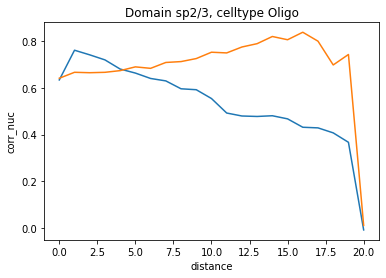

In [193]:
#for dom in good_domains:
reads_ctd=reads_assignedsub[reads_assignedsub['domain']==dom]
expression_distances=pd.crosstab(reads_ctd['distance'],reads_ctd['feature_name'])
reads_ctd_nucl=pd.crosstab(reads_ctd['overlaps_nucleus'],reads_ctd['feature_name'])
reads_ctd_nucl=reads_ctd_nucl.loc[:,reads_ctd_nucl.columns.isin(background_express.columns)]
reads_ctd_nucl=reads_ctd_nucl.sort_values(by='feature_name', axis=1)
bck_sub=background_express.loc[:,background_express.columns.isin(reads_ctd_nucl.columns)]
bck_sub=bck_sub.sort_values(by='feature_name', axis=1)
expression_distances=expression_distances.loc[:,expression_distances.columns.isin(reads_ctd_nucl.columns)]
expression_distances=expression_distances.sort_values(by='feature_name', axis=1)
#expression_distances=expression_distances.div(expression_distances.sum(axis=0),axis=1) ###
expression_distances=np.log(expression_distances+1)
# distances
reads_assigned_others=reads_assigned
reads_assigned_others=reads_assigned_others[reads_assigned_others['overlaps_nucleus']==1]
reads_sel=reads_assigned_others.groupby('initial_annotation').count()[reads_assigned_others.groupby('initial_annotation').count()>500]
selclus=reads_sel[~reads_sel.iloc[:,0].isna()].index
expression_patterns=pd.crosstab(reads_assigned_others['initial_annotation'],reads_assigned_others['feature_name'])
expression_patterns=expression_patterns.loc[:,expression_patterns.columns.isin(expression_distances.columns)]
expression_distances2=expression_distances.loc[:,expression_distances.columns.isin(expression_patterns.columns)]
expression_patterns=expression_patterns.loc[:,expression_distances2.columns]
#expression_patterns=expression_patterns.div(expression_patterns.sum(axis=0),axis=1)
expression_patterns=np.log(expression_patterns+1)
corr_nuc=[]
corr_bck=[]
specall=[]
for dist in expression_distances.index:
    corr_bck.append(np.corrcoef(expression_distances.loc[dist,:],bck_sub.loc[dom,:])[0,1])
    corr_nuc.append(np.corrcoef(expression_distances.loc[dist,:],reads_ctd_nucl.loc[1,:])[0,1])
    spec=[]
    for selcl in selclus:
        spec.append(np.corrcoef(expression_distances2.loc[dist,:],expression_patterns.loc[selcl,:])[0,1])
    specall.append(spec)
summary=pd.DataFrame([corr_nuc,corr_bck],columns=expression_distances.index,index=['corr_nuc','corr_back']).transpose()
summary['corr_nuc']=summary['corr_nuc'].astype(float)
summary['diff']=summary['corr_nuc']-summary['corr_back']
plt.figure()
sns.lineplot(data=summary,x='distance',y='corr_nuc')
sns.lineplot(data=summary,x='distance',y='corr_back')
plt.title('Domain '+str(dom)+', celltype ' + str(CELLTYPE) )
try:
    tdistance=np.min(summary.loc[summary['diff']<0.1,:].index)
except:
    tdistance=np.max(summary.index)
if str(np.min(summary.loc[summary['diff']<0.1,:].index))=='nan':
    tdistance=np.max(summary.index)
turnover_summ.loc[dom,CELLTYPE]=tdistance
tdistanceall.append(tdistance)
reads_ctdsub=reads_ctd[reads_ctd['overlaps_nucleus']==1]
cellm.append(dist_nuc(reads_ctd))
nuclim.append(dist_nuc(reads_ctdsub))
# end of loop    

In [194]:
corrs_all=pd.DataFrame(specall,columns=selclus,index=expression_distances.index)

In [195]:
corrs_all

initial_annotation,Astro1,Astro2,CA1,CA2_3,COP,CP,Cajal Retzius,Car3 EXC,Car4+ EC,Car4- EC,...,Microglia,OPC,Oligo,Pericytes,Perivascular_macrophages,Pvalb INH,Sst INH,Thalamic EXC,VLMC,Vip INH
distance,,,,,,,,,,,,,,,,,,,,,
0.0,0.330867,0.272066,0.407147,0.478963,0.409136,0.120742,0.273855,0.305497,0.339247,0.231752,...,0.346283,0.357082,0.394422,0.217467,0.189247,0.257569,0.246699,0.281899,0.146130,0.272311
1.0,0.475064,0.403118,0.545477,0.647988,0.576808,0.238845,0.399586,0.379171,0.420583,0.261777,...,0.432784,0.503307,0.588599,0.283018,0.175651,0.397344,0.358720,0.417449,0.177010,0.398957
2.0,0.515540,0.441690,0.594451,0.710726,0.574631,0.303000,0.403488,0.405089,0.460878,0.312826,...,0.475959,0.523128,0.610847,0.309270,0.233798,0.406483,0.353755,0.404380,0.216219,0.405521
3.0,0.536569,0.449520,0.640297,0.756043,0.579884,0.287339,0.447623,0.462367,0.460168,0.297764,...,0.494676,0.557254,0.627793,0.328039,0.238681,0.464879,0.413924,0.430202,0.220036,0.450235
4.0,0.580047,0.487876,0.673969,0.787321,0.569775,0.292409,0.472869,0.443969,0.474857,0.300303,...,0.505959,0.565718,0.631901,0.330605,0.228305,0.463603,0.407677,0.457651,0.216856,0.461129
5.0,0.566556,0.474352,0.674697,0.789507,0.555955,0.295352,0.429984,0.448534,0.480573,0.321263,...,0.481281,0.552525,0.601957,0.331241,0.227129,0.443403,0.389017,0.417433,0.211566,0.425164
6.0,0.553643,0.462070,0.661621,0.802977,0.544468,0.288754,0.443638,0.453901,0.482603,0.338107,...,0.465506,0.551733,0.583644,0.346068,0.216248,0.462617,0.428017,0.436826,0.218570,0.446141
7.0,0.568202,0.468891,0.664325,0.803972,0.540175,0.286069,0.466526,0.430909,0.491610,0.333945,...,0.500892,0.553023,0.600661,0.341012,0.252545,0.481570,0.439447,0.431542,0.229242,0.463022
8.0,0.555930,0.463691,0.681363,0.816998,0.507571,0.302431,0.464038,0.452372,0.493854,0.343134,...,0.497908,0.554824,0.580991,0.367446,0.248252,0.478552,0.456976,0.459180,0.238389,0.479017


In [196]:
np.log(corrs_all)

/home/sergioms/.local/lib/python3.8/site-packages/pandas/core/internals/blocks.py:402: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


initial_annotation,Astro1,Astro2,CA1,CA2_3,COP,CP,Cajal Retzius,Car3 EXC,Car4+ EC,Car4- EC,...,Microglia,OPC,Oligo,Pericytes,Perivascular_macrophages,Pvalb INH,Sst INH,Thalamic EXC,VLMC,Vip INH
distance,,,,,,,,,,,,,,,,,,,,,
0.0,-1.106038,-1.301711,-0.898582,-0.736132,-0.893707,-2.114097,-1.295158,-1.185816,-1.081027,-1.462089,...,-1.060500,-1.029789,-0.930334,-1.525710,-1.664704,-1.356466,-1.399586,-1.266207,-1.923261,-1.300809
1.0,-0.744306,-0.908525,-0.606094,-0.433882,-0.550246,-1.431939,-0.917327,-0.969768,-0.866113,-1.340261,...,-0.837517,-0.686555,-0.530011,-1.262245,-1.739258,-0.922954,-1.025213,-0.873593,-1.731548,-0.918901
2.0,-0.662541,-0.817147,-0.520117,-0.341468,-0.554028,-1.194022,-0.907610,-0.903648,-0.774622,-1.162107,...,-0.742425,-0.647929,-0.492909,-1.173541,-1.453298,-0.900213,-1.039151,-0.905401,-1.531461,-0.902582
3.0,-0.622559,-0.799574,-0.445822,-0.279658,-0.544928,-1.247093,-0.803805,-0.771397,-0.776163,-1.211456,...,-0.703852,-0.584734,-0.465544,-1.114624,-1.432629,-0.765979,-0.882073,-0.843501,-1.513965,-0.797985
4.0,-0.544647,-0.717694,-0.394571,-0.239119,-0.562514,-1.229601,-0.748936,-0.812001,-0.744742,-1.202962,...,-0.681300,-0.569659,-0.459022,-1.106830,-1.477072,-0.768728,-0.897279,-0.781648,-1.528520,-0.774076
5.0,-0.568179,-0.745805,-0.393491,-0.236346,-0.587067,-1.219589,-0.844007,-0.801771,-0.732776,-1.135494,...,-0.731305,-0.593257,-0.507569,-1.104909,-1.482237,-0.813275,-0.944132,-0.873631,-1.553221,-0.855280
6.0,-0.591236,-0.772039,-0.413062,-0.219429,-0.607945,-1.242180,-0.812746,-0.789877,-0.728560,-1.084392,...,-0.764631,-0.594691,-0.538464,-1.061119,-1.531331,-0.770855,-0.848593,-0.828220,-1.520651,-0.807120
7.0,-0.565279,-0.757386,-0.408984,-0.218190,-0.615862,-1.251524,-0.762442,-0.841859,-0.710070,-1.096779,...,-0.691365,-0.592355,-0.509725,-1.075838,-1.376166,-0.730704,-0.822239,-0.840391,-1.472978,-0.769980
8.0,-0.587113,-0.768537,-0.383660,-0.202118,-0.678119,-1.195901,-0.767788,-0.793251,-0.705515,-1.069635,...,-0.697340,-0.589104,-0.543019,-1.001180,-1.393313,-0.736991,-0.783124,-0.778313,-1.433853,-0.736019


In [197]:
meand_celltype.append(np.mean(tdistanceall))
nuclimall.append(np.mean(nuclim))
cellmall.append(np.mean(cellm))

In [198]:
corrs_all=corrs_all.loc[:,np.max(corrs_all)>0.1]

/home/sergioms/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.max(axis=None) will return a scalar max over the entire DataFrame. To retain the old behavior, use 'frame.max(axis=0)' or just 'frame.max()'
  return reduction(axis=axis, out=out, **passkwargs)


<AxesSubplot:xlabel='distance'>

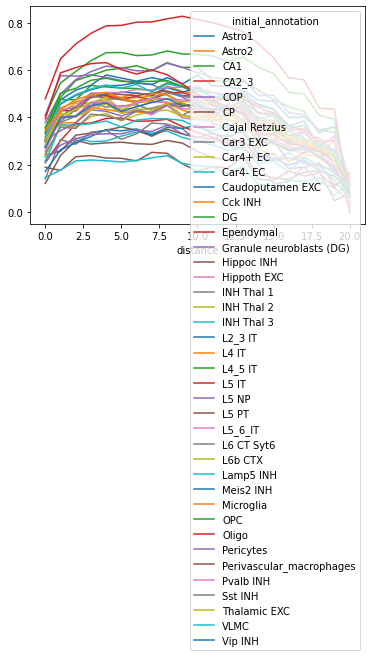

In [199]:
corrs_all.plot()

# read baysor

In [13]:
reads_baysor=pd.read_csv(r"E:\Xenium_data\prerelease_2_msbrain\xenium_prerelease_jun20_mBrain_replicates\output\baysor_s10\segmentation.csv")

In [14]:
reads_baysor

,object_id,cell_id,gene,x,y,z_location,qv,molecule_id,confidence,cluster,cell,assignment_confidence,is_noise,ncv_color
0,5,-1,Lyz2,155.28462,729.986800,13.411962,26.048860,1,0.99597,1,458,0.98,False,#009583
1,7,1062,Car4,97.84823,16.919405,13.693128,26.754816,2,0.98799,3,0,0.94,True,#00B5C6
2,12,11,Parm1,437.75302,5.232364,14.329203,40.000000,3,0.00450,1,0,1.00,True,#00988B
3,13,1060,Dkk3,28.85770,7.931882,13.763431,27.914576,4,0.00007,4,0,1.00,True,#00B47F
4,15,1062,Neurod6,96.17911,19.679377,13.744028,36.030350,5,0.43767,4,0,1.00,True,#85ABFF
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6833556,8966367,22603,Rasgrf2,2572.10500,4034.105500,20.270582,40.000000,6833557,0.99982,1,16840,1.00,False,#665828
6833557,8966368,22603,Rasgrf2,2574.10000,4036.759000,20.378021,40.000000,6833558,1.00000,1,16840,1.00,False,#654F00
6833558,8966370,22813,Rasgrf2,2863.46530,3698.239500,21.047360,40.000000,6833559,0.99999,4,18844,1.00,False,#58CDFF
6833559,8966371,22502,Nell1,2696.53540,3813.285600,20.776398,20.607689,6833560,1.00000,4,16762,1.00,False,#90DDFF


In [15]:
len(reads_baysor['cell'].unique())

53034

In [16]:
saving_path=r'E:\Xenium_data\prerelease_2_msbrain\xenium_prerelease_jun20_mBrain_replicates\output\3replicates_original'
abaysor=sc.read(saving_path+'/adata_baysor_s10_replicate1.h5ad')

In [17]:
len(abaysor.obs['cell'].unique())

25866

In [18]:
id_cluster_2=dict(zip(abaysor.obs['cell'],abaysor.obs['leiden_1_4']))

In [19]:
reads_baysor['baysor_leiden_1_4']=reads_baysor['cell'].astype(int).map(id_cluster_2)

In [20]:
# basic merging

In [21]:
reads_merged=reads_original.merge(reads_baysor,on='object_id')

In [22]:
reads_merged['assigned_orginial']=reads_merged['cell_id_x']!=-1

In [23]:
reads_merged

,object_id,cell_id_x,feature_name,x_location,y_location,z_location_x,qv_x,cluster_1_4,cell_id_y,gene,...,qv_y,molecule_id,confidence,cluster,cell,assignment_confidence,is_noise,ncv_color,baysor_leiden_1_4,assigned_orginial
0,5,-1,Lyz2,155.28462,729.986800,13.411962,26.048860,NaN,-1,Lyz2,...,26.048860,1,0.99597,1,458,0.98,False,#009583,42,False
1,7,1062,Car4,97.84823,16.919405,13.693128,26.754816,11_Astrocytes,1062,Car4,...,26.754816,2,0.98799,3,0,0.94,True,#00B5C6,NaN,True
2,12,11,Parm1,437.75302,5.232364,14.329203,40.000000,11_Astrocytes,11,Parm1,...,40.000000,3,0.00450,1,0,1.00,True,#00988B,NaN,True
3,13,1060,Dkk3,28.85770,7.931882,13.763431,27.914576,18_Astrocytes?,1060,Dkk3,...,27.914576,4,0.00007,4,0,1.00,True,#00B47F,NaN,True
4,15,1062,Neurod6,96.17911,19.679377,13.744028,36.030350,11_Astrocytes,1062,Neurod6,...,36.030350,5,0.43767,4,0,1.00,True,#85ABFF,NaN,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6833556,8966367,22603,Rasgrf2,2572.10500,4034.105500,20.270582,40.000000,33_TEINH17_inh_cort,22603,Rasgrf2,...,40.000000,6833557,0.99982,1,16840,1.00,False,#665828,34,True
6833557,8966368,22603,Rasgrf2,2574.10000,4036.759000,20.378021,40.000000,33_TEINH17_inh_cort,22603,Rasgrf2,...,40.000000,6833558,1.00000,1,16840,1.00,False,#654F00,34,True
6833558,8966370,22813,Rasgrf2,2863.46530,3698.239500,21.047360,40.000000,22_Exc Cortex,22813,Rasgrf2,...,40.000000,6833559,0.99999,4,18844,1.00,False,#58CDFF,25,True
6833559,8966371,22502,Nell1,2696.53540,3813.285600,20.776398,20.607689,31_Exc cort,22502,Nell1,...,20.607689,6833560,1.00000,4,16762,1.00,False,#90DDFF,18,True


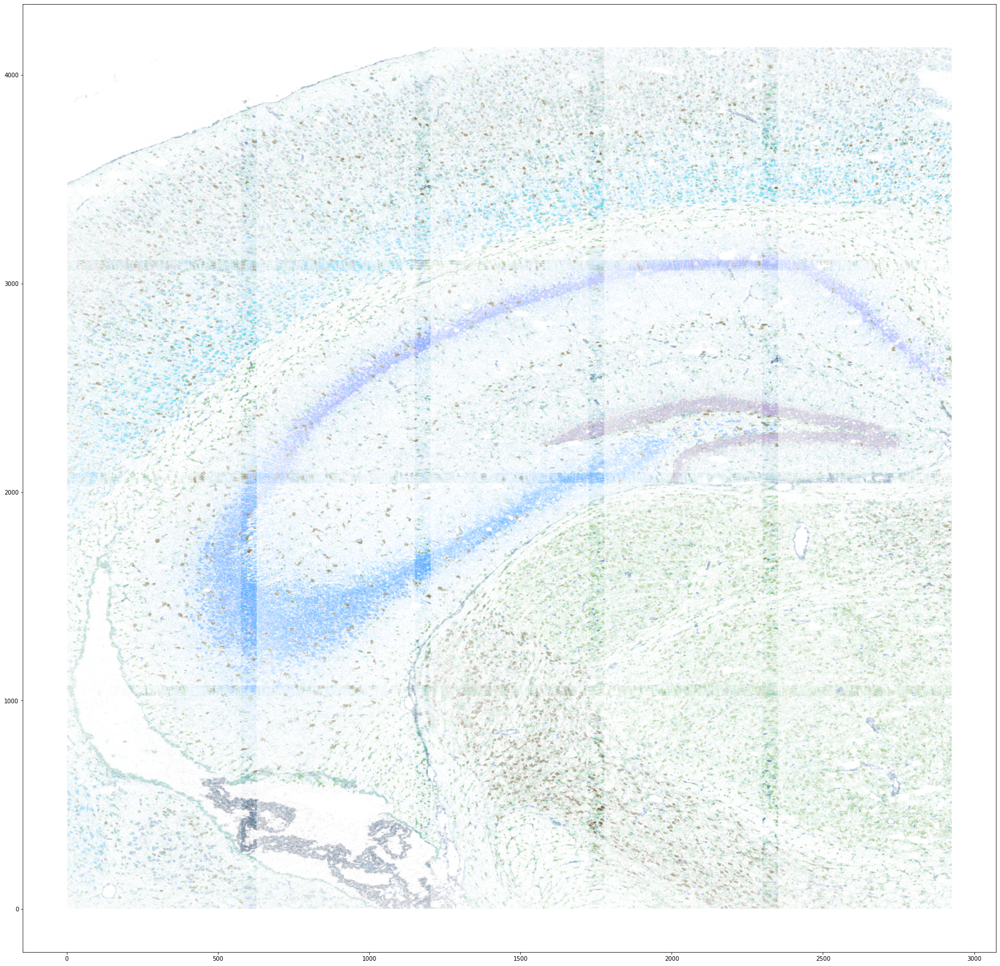

In [24]:
plt.figure(figsize=(30,30))
plt.scatter(x=reads_merged['x_location'],y=reads_merged['y_location'],c=reads_merged['ncv_color'],s=0.0001)

In [25]:
reads_merged['assigned_orginial']=reads_merged['cell_id_x']!=-1
reads_merged['assigned_baysor']=reads_merged['is_noise']==False

In [26]:
reads_merged['assigned_common']='OR_'+reads_merged['assigned_orginial'].astype(str)+'_BAY_'+reads_merged['assigned_baysor'].astype(str)

In [27]:
reads_merged.to_csv(r'E:\Xenium_data\prerelease_2_msbrain\xenium_prerelease_jun20_mBrain_replicates\output\baysor_s2\reads_original_baysor_merged_s10.csv')

# Let's compute the confusion

In [28]:
clusters_comparison=pd.crosstab(reads_merged['cell_id_x'],reads_merged['baysor_leiden_1_4'])

In [29]:
origc_bayscluster=clusters_comparison.idxmax(axis=1)

In [30]:
origc_bayscluster_dict=dict(zip(origc_bayscluster.index,list(origc_bayscluster)))

In [31]:
adata.obs['baysor_cluster']=list(adata.obs['cell_id'].map(origc_bayscluster_dict))

In [32]:
adata.obs['X_umap']=list(pd.DataFrame(adata.obsm['X_umap'])[0])
adata.obs['Y_umap']=list(pd.DataFrame(-adata.obsm['X_umap'])[1])

In [33]:
adata.obs.to_csv(r'E:\Xenium_data\prerelease_2_msbrain\xenium_prerelease_jun20_mBrain_replicates\output\baysor_s10/original_data_clustering_baysor_transfered.csv')

In [34]:
clusters_comparison=pd.crosstab(reads_merged['cell'],reads_merged['cluster_1_4'])

In [35]:
bays_oricluster=clusters_comparison.idxmax(axis=1)

In [36]:
bays_oricluster_dict=dict(zip(bays_oricluster.index,list(bays_oricluster)))

In [37]:
abaysor

AnnData object with n_obs × n_vars = 25866 × 284
    obs: 'index', 'cell', 'x', 'y', 'cluster', 'n_transcripts', 'density', 'elongation', 'area', 'avg_confidence', 'replicate', 'total_counts', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6'
    uns: 'hvg', 'leiden', 'leiden_1_4_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [38]:
abaysor.obs['original_cluster']=list(abaysor.obs['cell'].map(bays_oricluster_dict))

In [39]:
abaysor.obs['X_umap']=list(pd.DataFrame(abaysor.obsm['X_umap'])[0])
abaysor.obs['Y_umap']=list(pd.DataFrame(-abaysor.obsm['X_umap'])[1])

In [40]:
abaysor.obs.to_csv(r'E:\Xenium_data\prerelease_2_msbrain\xenium_prerelease_jun20_mBrain_replicates\output\baysor_s10/baysor_s10_data_clustering_original_transfered.csv')

In [ ]:
clusters_comparison=pd.crosstab(reads_merged['cell'],reads_merged['cluster_1_4'])